# Mid-Term Take Home 
# Unified Model of Gender and Emotion Detection *TensorFlow Version*
<div style="text-align: right">Uday Kiran Dasari</div>
<div style="text-align: right">Sharath Chandra</div>

### Abstract:

This project aims to develop a unified machine learning model to predict both the gender of individuals in images (male/female) and their emotional state (happy/sad). Leveraging two separate datasets containing images labeled with emotions and gender, the model will be trained to classify images accordingly. Through a combination of feature extraction, image processing, and deep learning techniques, the model seeks to provide accurate predictions for both gender and emotional expression simultaneously. The integration of these dual predictions offers a comprehensive understanding of individuals' characteristics depicted in images, with potential applications in various domains such as facial recognition, social robotics, and sentiment analysis.

### What are the steps we took to achieve this goal? ( Considering that we have emotion and gender datasets separately)
*  Importing the necessary libraries
*  Reading the .h5 file ( Emotion Dataset; having, Images and their respective emotions ) and loading both training and test data
*  Loading Gender Dataset ( We ll load both training and test data , keep all of it ready )
*  Lenet - 5 Model
   - What is Lenet-5?
   - How does it work?
   - How Did it help us?
*  Normalising the Emotion Dataset.   
*  Importance of Dataset Balance when working with multiple predictions.
*  Training Lenet - 5 using emotion dataset
*  Emotion Prediction
*  Updating the Gender Dataset with emotions.
*  Building Models with experimental architectures.

### Importing Necessary Libraries

In [1]:
import numpy as np
import pandas as pd
from tqdm import tqdm
import os
import matplotlib.pyplot as plt
import seaborn as sns
import random
import h5py
from tqdm import tqdm
from sklearn.metrics import accuracy_score

In [2]:
import tensorflow as tf
from keras.preprocessing.image import img_to_array, load_img
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Flatten, Dense, Dropout
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.layers import Conv2D, AveragePooling2D, Flatten, Dense
from tensorflow.keras.preprocessing import image

from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

### Reading data from '.h5' file for emotion dataset

Since we have Training and test data but both of files are in .h5 files, lets prepare our train and test data for emotion dataset.

In [3]:
train_dataset = h5py.File(r'/Users/sharathchandra/Desktop/NeuralNets/MidTermTakeHome_Group4/train_happy.h5') 
for key in train_dataset.keys():
    print(key)

list_classes
train_set_x
train_set_y


In [4]:
test_dataset = h5py.File(r'/Users/sharathchandra/Desktop/NeuralNets/MidTermTakeHome_Group4/test_happy.h5') 
for key in test_dataset.keys():
    print(key)

list_classes
test_set_x
test_set_y


In [5]:
train_x_emotion = np.array(train_dataset['train_set_x'][:]) 
train_y_emotion = np.array(train_dataset['train_set_y'][:])
print(f"train_x_emotion:{train_x_emotion.shape},\ntrain_y_emotion:{train_y_emotion.shape}")

test_x_emotion = np.array(test_dataset['test_set_x'][:])
test_y_emotion = np.array(test_dataset['test_set_y'][:])
print(f"test_x_emotion:{test_x_emotion.shape},\ntest_y_emotion:{test_y_emotion.shape}")

# y reshaped
train_y_emotion = train_y_emotion.reshape((1, train_x_emotion.shape[0]))
test_y_emotion = test_y_emotion.reshape((1, test_y_emotion.shape[0]))
print(f"train_y_emotion:{train_y_emotion.shape},\ntest_y_emotion:{test_y_emotion.shape}")

train_x_emotion:(600, 64, 64, 3),
train_y_emotion:(600,)
test_x_emotion:(150, 64, 64, 3),
test_y_emotion:(150,)
train_y_emotion:(1, 600),
test_y_emotion:(1, 150)


### Emotion Dataset

In this step, we ll be looking how the data looks like in our emotion dataset.

X_train_emotion.shape =  (600, 64, 64, 3)
X_test_emotion.shape =  (150, 64, 64, 3)
index =  58 , result =  0


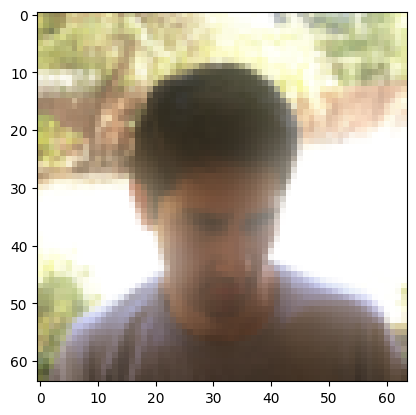

In [6]:
X_train_emotion = np.array(train_dataset['train_set_x'][:])
y_train_emotion = np.array(train_dataset['train_set_y'][:])

X_test_emotion = np.array(test_dataset['test_set_x'][:])
y_test_emotion = np.array(test_dataset['test_set_y'][:])

print('X_train_emotion.shape = ', X_train_emotion.shape)
print('X_test_emotion.shape = ', X_test_emotion.shape)

index = random.randint(1,600)
plt.imshow(X_train_emotion[index])
print('index = ', index,', result = ', y_train_emotion[index])

#### Visualising the data in emotion dataset.

Images range :(1 , 15)


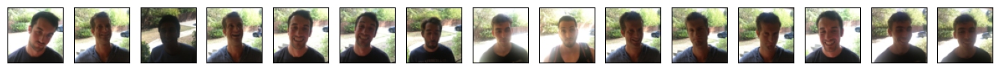

Images range :(16 , 30)


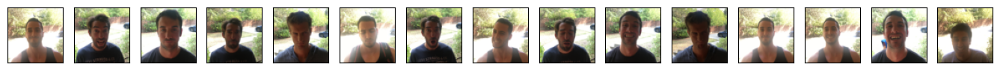

Images range :(31 , 45)


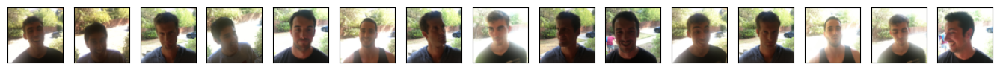

Images range :(46 , 60)


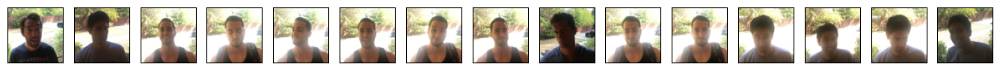

Images range :(61 , 75)


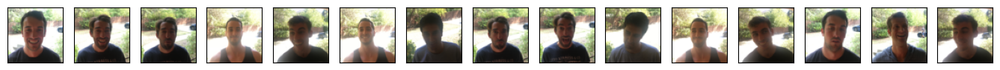

Images range :(76 , 90)


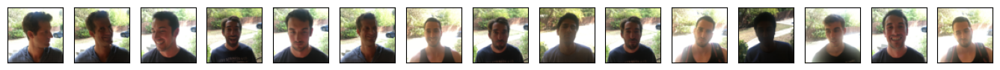

Images range :(91 , 105)


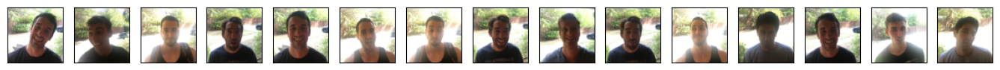

Images range :(106 , 120)


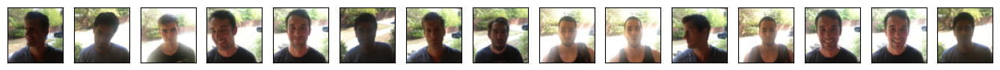

Images range :(121 , 135)


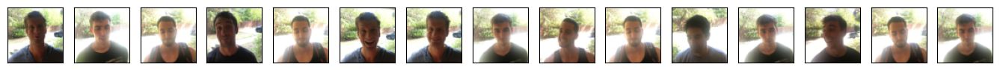

Images range :(136 , 150)


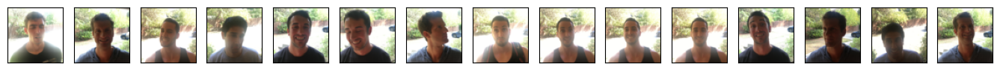

Images range :(151 , 165)


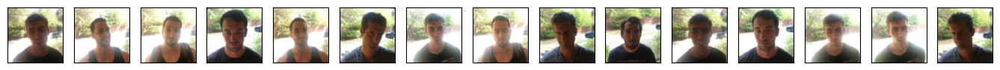

Images range :(166 , 180)


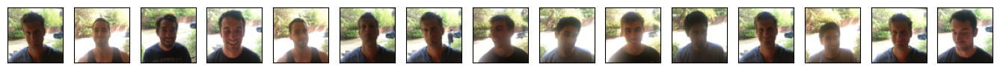

Images range :(181 , 195)


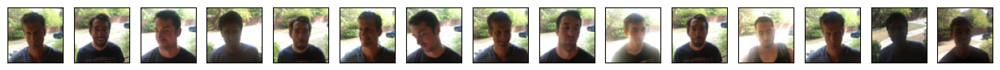

Images range :(196 , 210)


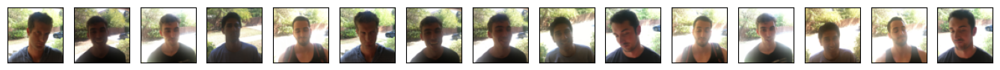

Images range :(211 , 225)


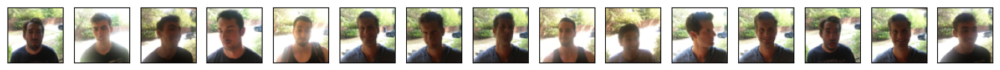

Images range :(226 , 240)


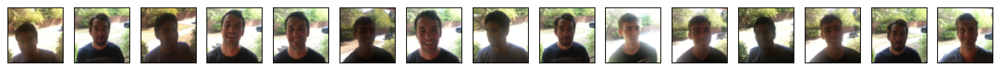

Images range :(241 , 255)


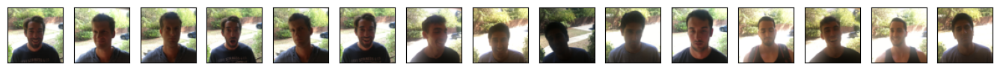

Images range :(256 , 270)


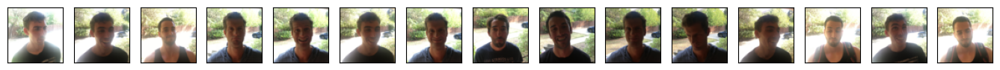

Images range :(271 , 285)


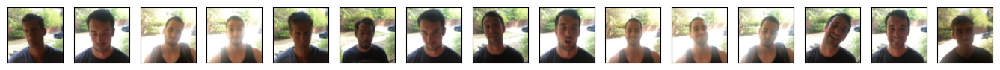

Images range :(286 , 300)


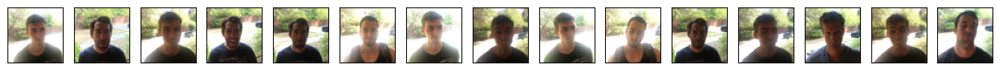

Images range :(301 , 315)


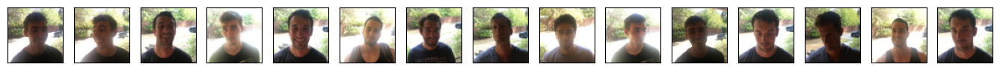

Images range :(316 , 330)


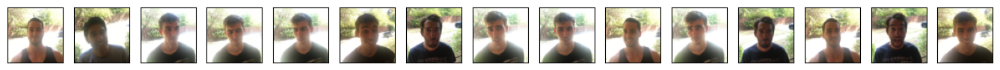

Images range :(331 , 345)


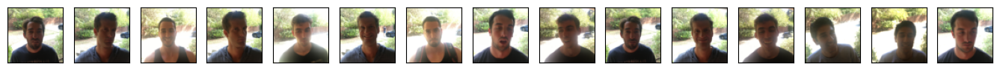

Images range :(346 , 360)


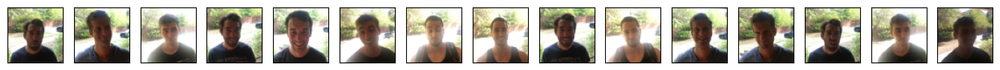

Images range :(361 , 375)


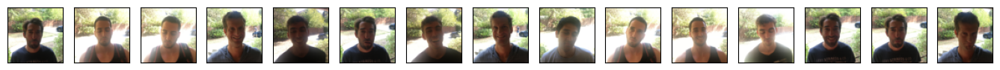

Images range :(376 , 390)


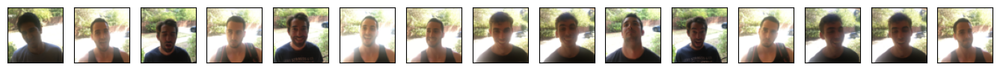

Images range :(391 , 405)


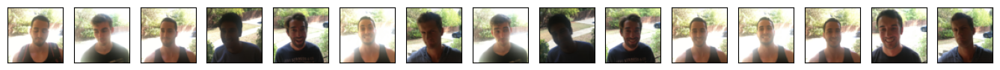

Images range :(406 , 420)


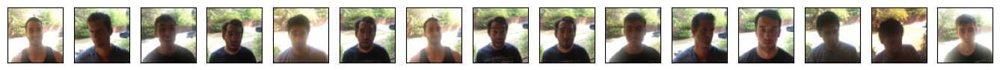

Images range :(421 , 435)


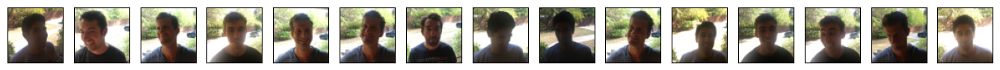

Images range :(436 , 450)


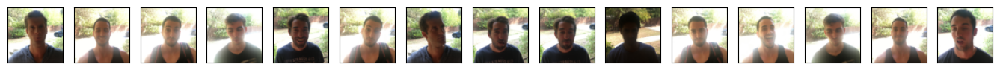

Images range :(451 , 465)


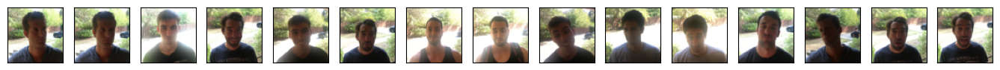

Images range :(466 , 480)


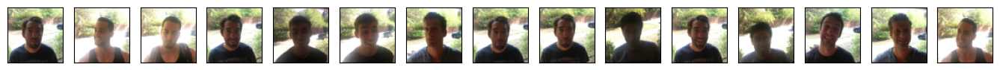

Images range :(481 , 495)


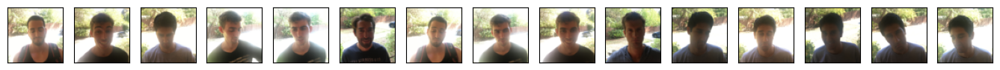

Images range :(496 , 510)


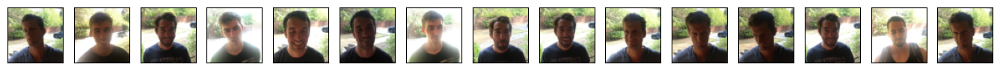

Images range :(511 , 525)


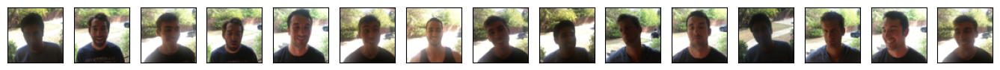

Images range :(526 , 540)


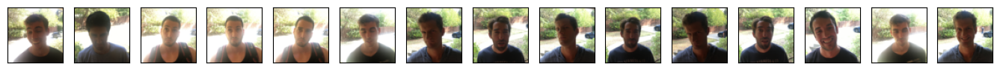

Images range :(541 , 555)


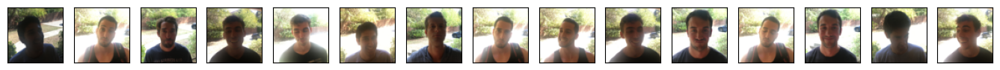

Images range :(556 , 570)


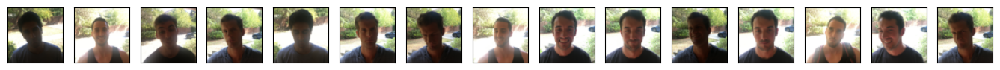

Images range :(571 , 585)


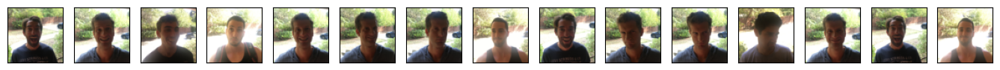

Images range :(586 , 600)


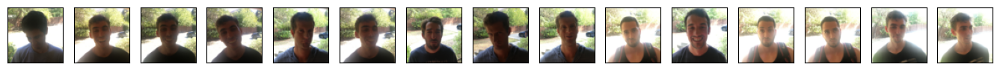

In [7]:
def visualise_data(images, grid_size=12):
    
    total_images = images.shape[0]

    for offset in range(0, total_images, grid_size):
        end_index = offset + grid_size
        if end_index > total_images:
            end_index = total_images

        plt.figure(figsize=(17, 17))
        print(f"Images range :({offset + 1} , {end_index})")

        for i in range(offset, end_index):
            plt.subplot(1, grid_size, i - offset + 1)
            plt.xticks([])
            plt.yticks([])
            plt.grid(False)
            plt.imshow(images[i], cmap=plt.cm.binary)
        plt.show()

# Explore the dataset in full subsets
visualise_data(X_train_emotion,15)

### Function to load the Gender Dataset

In [9]:
def load_gender_dataset(gender_folder_path, target_size=(64, 64)):
    X = []
    y = [] # 0 for female, 1 for male
    categories = ['female', 'male']

    for category in categories:
        directory = os.path.join(gender_folder_path, category)
        #label = categories.index(category)
        for filename in tqdm(os.listdir(directory)):
            if filename.endswith(".jpg"):
                path = os.path.join(directory, filename)
                img = load_img(path, target_size=target_size)
                img_array = img_to_array(img)
                X.append(img_array)
                #y.append(label)
                y.append(category)

    return np.array(X), np.array(y)

This part of the code imports necessary libraries including os for file operations, load_img and img_to_array from Keras for loading and converting images to arrays, tqdm for displaying progress bars, and numpy for numerical operations.This function load_gender_dataset() takes two parameters: gender_folder_path which is the path to the folder containing the gender dataset, and target_size which is the target size for resizing the images (default is (64, 64))

#### Upnext, we are only loading the gender dataset and storing it in variables.This happens both for train and test data.

#### Training 

In [10]:
# Assuming your gender dataset folder paths are structured like 'path/to/gender_dataset/'
gender_folder_path = './Training/'
X_train_gender, y_train_gender = load_gender_dataset(gender_folder_path)
print('X_train_gender.shape = ', X_train_gender.shape)
print('y_train_gender.shape = ', y_train_gender.shape)

100%|███████████████████████████████████| 23766/23766 [00:06<00:00, 3401.69it/s]


X_train_gender.shape =  (47009, 64, 64, 3)
y_train_gender.shape =  (47009,)


#### Testing

In [11]:
gender_folder_path = './Validation/'
X_test_gender, y_test_gender = load_gender_dataset(gender_folder_path)
print('X_test_gender.shape = ', X_test_gender.shape)
print('y_test_gender.shape = ', y_test_gender.shape)

100%|█████████████████████████████████████| 5808/5808 [00:01<00:00, 3135.10it/s]


X_test_gender.shape =  (11649, 64, 64, 3)
y_test_gender.shape =  (11649,)


### Lenet 5 Model

In [14]:
def CNN_Model(input_shape,num_classes,dropout_layers=0,learning_rate=0.001):
    print(f"Dropout Layers:{dropout_layers}\nLearning Rate:{learning_rate}")
    if dropout_layers>3:
        print( "More than three dropout layers!! Change Model Architecture!!!")
        return
    else:
        model = Sequential()

        # C1 Convolutional Layer
        model.add(Conv2D(filters=6, kernel_size=(5, 5), activation='tanh', input_shape=input_shape))
        print("CL1")

        # S2 Pooling Layer
        model.add(AveragePooling2D(pool_size=(2, 2)))
        print("AP1")

        if dropout_layers>0:
            # Adding dropout
            model.add(Dropout(0.25))
            dropout_layers=dropout_layers-1
            print(f"DO1,{dropout_layers}")
            

        # C3 Convolutional Layer
        model.add(Conv2D(filters=16, kernel_size=(5, 5), activation='tanh'))
        print("CL2")
        
        # S4 Pooling Layer
        model.add(AveragePooling2D(pool_size=(2, 2)))
        print("AP2")
        
        if dropout_layers>0:
            # Adding dropout
            model.add(Dropout(0.25))
            dropout_layers=dropout_layers-1
            print(f"DO2,{dropout_layers}")

        # C5 Fully Connected Convolutional Layer
        model.add(Conv2D(filters=120, kernel_size=(5, 5), activation='tanh'))
        print("CL3")

        # Flattening the layers
        model.add(Flatten())
        print("Flatten")

        # F6 Fully Connected Layer
        model.add(Dense(units=84, activation='tanh'))
        print("Dense1")
        
        if dropout_layers>0:
            # Adding dropout
            model.add(Dropout(0.25))
            dropout_layers=dropout_layers-1        
            print(f"DO3,{dropout_layers}")

        # Output Layer with softmax activation for 4 classes
        model.add(Dense(units=num_classes, activation='softmax'))
        print("Dense2")

        # Compile the model with a loss function suitable for a classification problem
        model.compile(loss='categorical_crossentropy', optimizer=Adam(learning_rate=learning_rate), metrics=['accuracy'])
        return model

### What is LeNet - 5 ?

* LeNet-5 is a convolutional neural network (CNN) architecture
* Layer Structure: LeNet-5 consists of seven layers:
    - Input layer
    - Convolutional layers (two convolutional layers)
    - Subsampling layers (two max-pooling layers)
    - Fully connected layers (three fully connected layers)
    - Output layer
    

### Key Components of LeNet 5
Convolutional Layers:
 - LeNet-5 starts with convolutional layers that apply filters to the input image to extract features. These convolutional layers learn to detect patterns like edges and textures.
 
Pooling Layers:
 - Following each convolutional layer, LeNet-5 uses pooling layers to reduce the spatial dimensions of the feature maps while retaining important information. Pooling helps make the representations more invariant to small translations and distortions in the input.
 
Fully Connected Layers:
 - After the convolutional and pooling layers, the feature maps are flattened and fed into fully connected layers. These layers learn high-level features and relationships between the extracted features, enabling classification.
 
Output Layer:
 - The final layer of LeNet-5 is a fully connected layer with softmax activation, producing output probabilities for each class. This layer computes the probability distribution over the possible classes, allowing the model to make predictions.

### Lets now create Emotion Model


#### Normalise the emotion dataset

In [15]:
# Normalize the images
X_train_emotion = X_train_emotion/ 255.0
X_test_emotion = X_test_emotion/ 255.0

# Convert labels to categorical (binary format)
y_train_emotion_cat = to_categorical(y_train_emotion, num_classes=2)
y_test_emotion_cat = to_categorical(y_test_emotion, num_classes=2)

#### Function to the show the dataset balance

In [18]:
def data_distribution(data, title='Data Distribution'):
    # Calculate counts and unique values
    unique, counts = np.unique(data, return_counts=True)
    count_dict = dict(zip(unique, counts))
    
    # Print counts
    print(count_dict)
    
    # Calculate percentages
    total = sum(counts)
    percentages = [(count / total) * 100 for count in counts]
    for unique_value, percentage in zip(unique, percentages):
        print(f'Value: {unique_value}, Count: {count_dict[unique_value]}, Percentage: {percentage:.2f}%')
    
    # Plot
    plt.figure(figsize=(10, 6))
    plt.bar(unique, counts, tick_label=[str(u) for u in unique])
    plt.title(title)
    plt.xlabel('Unique Values')
    plt.ylabel('Counts')
    plt.show()

{0: 300, 1: 300}
Value: 0, Count: 300, Percentage: 50.00%
Value: 1, Count: 300, Percentage: 50.00%


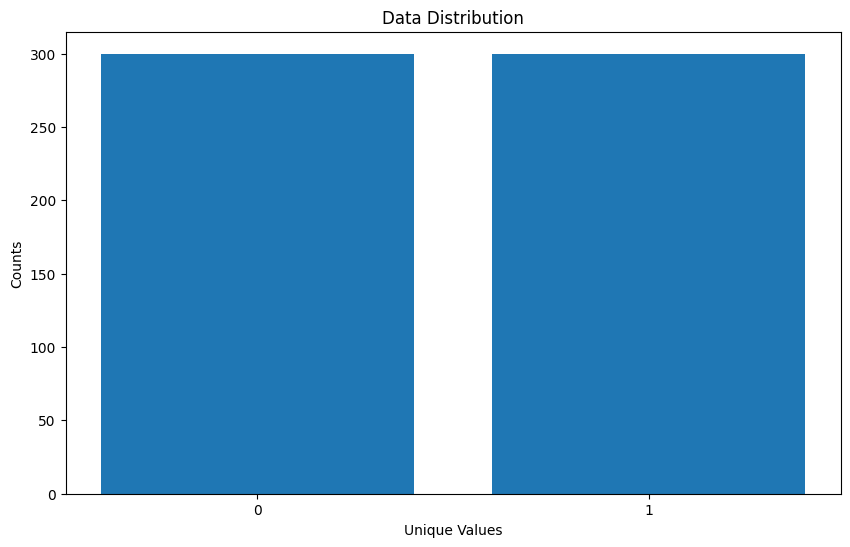

{0: 66, 1: 84}
Value: 0, Count: 66, Percentage: 44.00%
Value: 1, Count: 84, Percentage: 56.00%


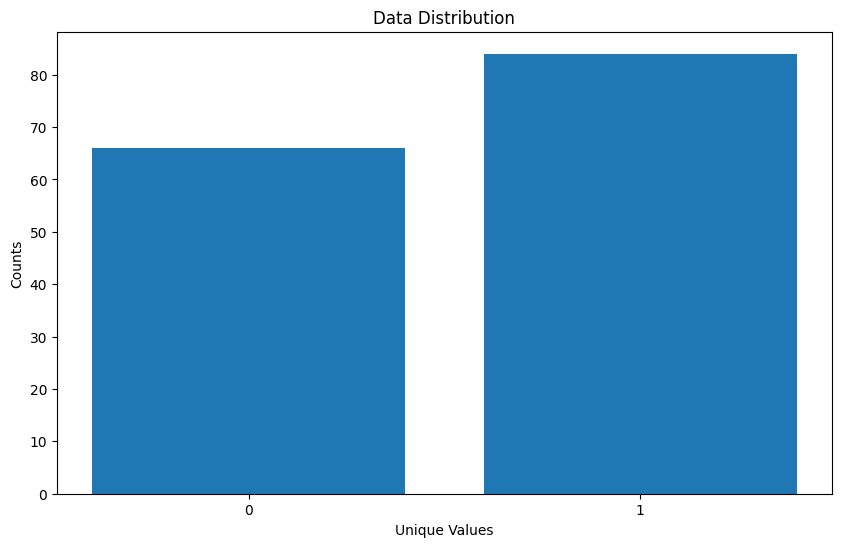

In [19]:
data_distribution(y_train_emotion)
data_distribution(y_test_emotion)

### Defining the EMOTION MODEL
#### Lets train the LeNet 5 Model with emotion Dataset


In [20]:
emotion_model=CNN_Model((64,64,3),2)
emotion_model.summary()

Dropout Layers:0
Learning Rate:0.001


CL1
AP1
CL2
AP2
CL3
Flatten
Dense1
Dense2
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 60, 60, 6)         456       
                                                                 
 average_pooling2d (Average  (None, 30, 30, 6)         0         
 Pooling2D)                                                      
                                                                 
 conv2d_1 (Conv2D)           (None, 26, 26, 16)        2416      
                                                                 
 average_pooling2d_1 (Avera  (None, 13, 13, 16)        0         
 gePooling2D)                                                    
                                                                 
 conv2d_2 (Conv2D)           (None, 9, 9, 120)         48120     
                                                                 
 flatten (Flat

In [21]:
# Train the model
history_emotion = emotion_model.fit(X_train_emotion, y_train_emotion_cat, epochs=20)

# Evaluate on the test set
test_loss, test_accuracy = emotion_model.evaluate(X_test_emotion,y_test_emotion_cat)
print(f"Test accuracy: {test_accuracy}, Test loss: {test_loss}")

Epoch 1/20
19/19 [==============================] - 1s 21ms/step - loss: 0.6968 - accuracy: 0.5133
Epoch 2/20
19/19 [==============================] - 0s 22ms/step - loss: 0.6918 - accuracy: 0.5267
Epoch 3/20
19/19 [==============================] - 0s 22ms/step - loss: 0.6749 - accuracy: 0.5900
Epoch 4/20
19/19 [==============================] - 0s 22ms/step - loss: 0.6016 - accuracy: 0.6917
Epoch 5/20
19/19 [==============================] - 0s 22ms/step - loss: 0.5400 - accuracy: 0.7067
Epoch 6/20
19/19 [==============================] - 0s 21ms/step - loss: 0.4081 - accuracy: 0.8100
Epoch 7/20
19/19 [==============================] - 0s 21ms/step - loss: 0.3277 - accuracy: 0.8717
Epoch 8/20
19/19 [==============================] - 0s 21ms/step - loss: 0.2891 - accuracy: 0.8867
Epoch 9/20
19/19 [==============================] - 0s 22ms/step - loss: 0.2227 - accuracy: 0.9150
Epoch 10/20
19/19 [==============================] - 0s 26ms/step - loss: 0.2189 - accuracy: 0.9050
Epoch 11/

In [22]:
#Making predictions on the test dataset
predictions = emotion_model.predict(X_test_emotion)

#Converting predictions to class labels
predicted_classes = np.argmax(predictions, axis=1)

#Comparing predicted classes to the true labels
accuracy = accuracy_score(predicted_classes,y_test_emotion)

print(f'Accuracy: {accuracy * 100:.2f}%')

5/5 [==============================] - 0s 8ms/step
Accuracy: 92.00%


### Emotion Prediction function

1/1 [==============================] - 0s 14ms/step
The image is: 0


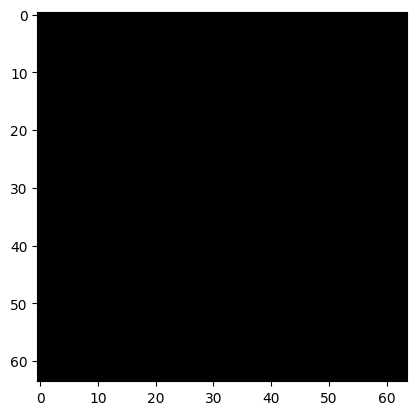

In [28]:
def detect_happy(model, img_array):
    # Assuming img_array is already in the correct shape (64, 64, 3) and normalized

    # Check if img_array needs to be expanded in its first dimension to match the input shape the model expects
    if img_array.ndim == 3:
        img_array = np.expand_dims(img_array, axis=0)

    # Make predictions using the model
    predictions = model.predict(img_array)

    # Get the predicted class (0 for sad, 1 for happy)
    predicted_class = np.argmax(predictions)

    return predicted_class
    # if predicted_class == 1:
    #     return "Happy"
    # else:
    #     return "Not Happy"

# Example usage assuming X_train_gender is indexed appropriately:
# Let's say you want to predict the emotion of the first image in X_train_gender
img_array = X_train_emotion[25]# This should be a (64, 64, 3) array if images are already preprocessed
plt.imshow(img_array)
result = detect_happy(emotion_model, img_array)
print(f"The image is: {result}")

In [29]:
X_test_emotion[0].shape

(64, 64, 3)

In [30]:
X_test_gender.shape

(11649, 64, 64, 3)

In [31]:
# Normalize the images
X_train_gender = X_train_gender/ 255.0
X_test_gender = X_test_gender/ 255.0

In [32]:
np.argmax(emotion_model.predict(np.expand_dims(X_train_gender[0],axis=0)))

1/1 [==============================] - 0s 20ms/step


1

In [33]:
np.unique(y_train_gender)

array(['female', 'male'], dtype='<U6')

### Function to update the 'Gender Dataset' with the emotion labels

In [34]:
%%time
def batch_happysadpred(model, img_array_batch):
    outputs = model.predict(img_array_batch, verbose=0)
    return np.argmax(outputs, axis=1)  

# Pre-allocate a numpy array for efficiency
#new_y_train_gender = np.empty_like(y_train_gender)

def genderemotion(X_train,y_train,model):
    # Process in batches to speed up prediction
    batch_size = 32  
    new_y_train=np.empty_like(y_train,dtype='<U15')
    for i in tqdm(range(0, X_train.shape[0], batch_size)):
        end_index = min(i + batch_size, X_train.shape[0]) 
        batch_outputs = batch_happysadpred(model, X_train[i:end_index])

        # Update the y_train_gender array based on the predictions
        for j, output in enumerate(batch_outputs):
            prefix = y_train[i+j]
            suffix = 'happy' if output == 1 else 'sad'
            # Adding an underscore separator for clarity
            new_y_train[i+j] = f"{prefix}_{suffix}"    
    return new_y_train

CPU times: user 7 µs, sys: 4 µs, total: 11 µs
Wall time: 185 µs


In [35]:
new_y_train_gender = genderemotion(X_train_gender,y_train_gender,emotion_model)
new_y_test_gender = genderemotion(X_test_gender,y_test_gender,emotion_model)

100%|█████████████████████████████████████████| 365/365 [00:09<00:00, 39.52it/s]


In summary, this code snippet efficiently predicts happy or sad emotions for images in batches, updates the labels accordingly, and measures the time taken for the process.

In [36]:
print(new_y_train_gender.shape, np.unique(new_y_train_gender))
print(new_y_test_gender.shape, np.unique(new_y_test_gender))

(47009,) ['female_happy' 'female_sad' 'male_happy' 'male_sad']
(11649,) ['female_happy' 'female_sad' 'male_happy' 'male_sad']


In [37]:
unique, counts = np.unique(y_train_emotion, return_counts=True)
print(dict(zip(unique, counts)))

{0: 300, 1: 300}


{'female_happy': 14113, 'female_sad': 9130, 'male_happy': 7413, 'male_sad': 16353}
Value: female_happy, Count: 14113, Percentage: 30.02%
Value: female_sad, Count: 9130, Percentage: 19.42%
Value: male_happy, Count: 7413, Percentage: 15.77%
Value: male_sad, Count: 16353, Percentage: 34.79%


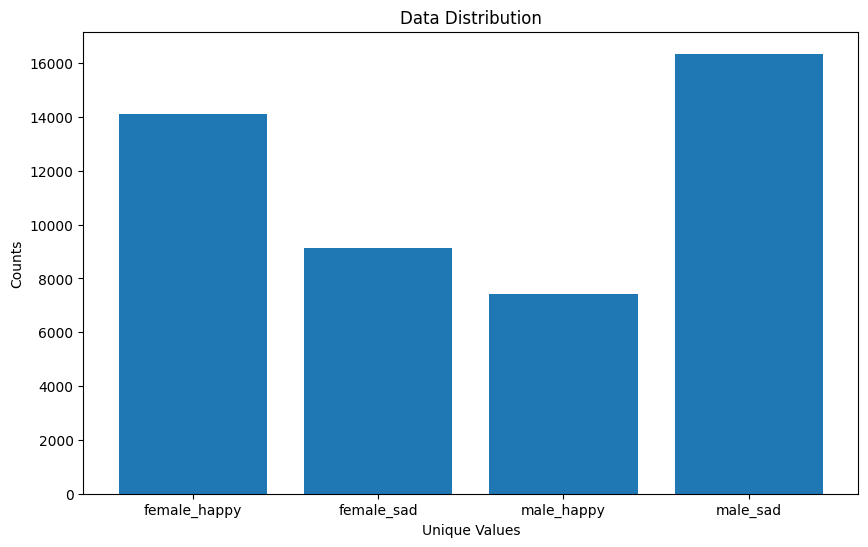

{'female_happy': 3564, 'female_sad': 2277, 'male_happy': 1795, 'male_sad': 4013}
Value: female_happy, Count: 3564, Percentage: 30.59%
Value: female_sad, Count: 2277, Percentage: 19.55%
Value: male_happy, Count: 1795, Percentage: 15.41%
Value: male_sad, Count: 4013, Percentage: 34.45%


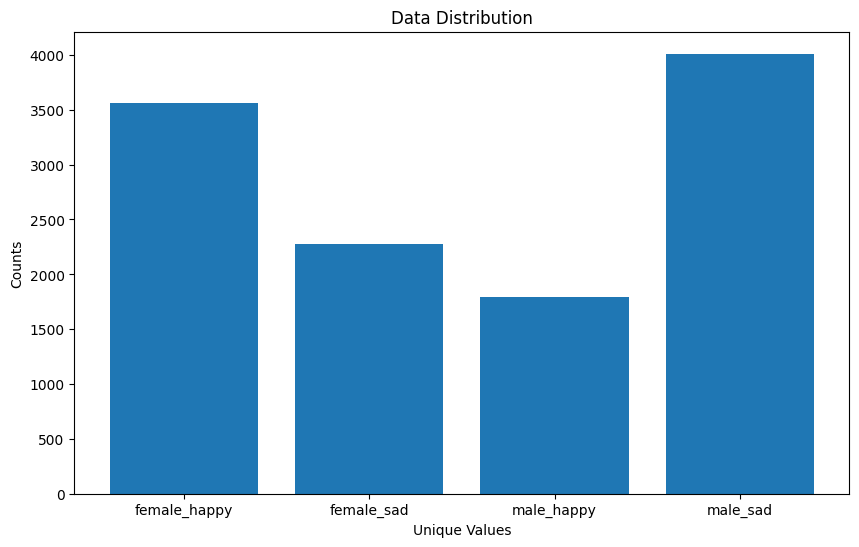

In [38]:
data_distribution(new_y_train_gender)
data_distribution(new_y_test_gender)

In [39]:
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical

label_encoder = LabelEncoder()
def encoding(y_train,label_encoder):
    # Convert string labels to integers
    integer_encoded = label_encoder.fit_transform(y_train)
    # Convert integers to one-hot encoded labels
    y_train_encoded = to_categorical(integer_encoded)
    return y_train_encoded

#Training
new_y_train_gender_encoded = encoding(new_y_train_gender,label_encoder)

#Testing
new_y_test_gender_encoded = encoding(new_y_test_gender,label_encoder)


# #Training
# # Convert string labels to integers
# label_encoder = LabelEncoder()
# integer_encoded = label_encoder.fit_transform(new_y_train_gender)
# # Convert integers to one-hot encoded labels
# new_y_train_gender_encoded = to_categorical(integer_encoded)
# #new_y_train_gender_encoded

# #Testing
# # Convert string labels to integers
# label_encoder = LabelEncoder()
# integer_encoded_test = label_encoder.fit_transform(new_y_test_gender)
# # Convert integers to one-hot encoded labels
# new_y_test_gender_encoded = to_categorical(integer_encoded_test)
# #new_y_test_gender_encoded


the code above, prepares categorical labels for training and testing data by converting them into one-hot encoded format, which is commonly used in machine learning tasks, especially in classification problems.

In [40]:
np.unique(new_y_train_gender_encoded)

array([0., 1.], dtype=float32)

In [41]:
new_y_train_gender_encoded.shape

(47009, 4)

Y labels are encoded as below

In [42]:
print(dict(zip(label_encoder.classes_, range(len(label_encoder.classes_)))))

{'female_happy': 0, 'female_sad': 1, 'male_happy': 2, 'male_sad': 3}


### Function to predict Gender & Emotion of an image

In [43]:
def decode_gender_emotion(label_encoder, model,img_path):
    # Inverse transform the encoded prediction back to the original label
    img = image.load_img(img_path,target_size=(64,64))
    img_array=image.img_to_array(img)
    minput = np.expand_dims(img_array,axis=0)
    prediction = np.argmax(model.predict(minput,verbose=0))
    decoded_label = label_encoder.inverse_transform([prediction])
    # Display the image
    plt.imshow(image.load_img(img_path))
    plt.axis('off') # Hide the axis
    plt.show()
    return decoded_label

### Model 1 with basic architecture

Input Shape : (64, 64, 3)

Image Size : 64x64 

num_classes=4 indicating that there are 4 output classes


In [44]:
gender_emotion_model1 = CNN_Model((64,64,3),4)
gender_emotion_model1.summary()

Dropout Layers:0
Learning Rate:0.001
CL1
AP1
CL2
AP2
CL3
Flatten
Dense1
Dense2
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 60, 60, 6)         456       
                                                                 
 average_pooling2d_2 (Avera  (None, 30, 30, 6)         0         
 gePooling2D)                                                    
                                                                 
 conv2d_4 (Conv2D)           (None, 26, 26, 16)        2416      
                                                                 
 average_pooling2d_3 (Avera  (None, 13, 13, 16)        0         
 gePooling2D)                                                    
                                                                 
 conv2d_5 (Conv2D)           (None, 9, 9, 120)         48120     
                                         

In [45]:
%%time
# Train the model
history_GE1 = gender_emotion_model1.fit(X_train_gender,new_y_train_gender_encoded,epochs=25,batch_size=32)

Epoch 1/25
1470/1470 [==============================] - 36s 24ms/step - loss: 0.5206 - accuracy: 0.7968
Epoch 2/25
1470/1470 [==============================] - 39s 26ms/step - loss: 0.3494 - accuracy: 0.8631
Epoch 3/25
1470/1470 [==============================] - 37s 25ms/step - loss: 0.4248 - accuracy: 0.8336
Epoch 4/25
1470/1470 [==============================] - 36s 24ms/step - loss: 0.4945 - accuracy: 0.8056
Epoch 5/25
1470/1470 [==============================] - 36s 25ms/step - loss: 0.4837 - accuracy: 0.8127
Epoch 6/25
1470/1470 [==============================] - 37s 25ms/step - loss: 0.4704 - accuracy: 0.8170
Epoch 7/25
1470/1470 [==============================] - 37s 25ms/step - loss: 0.4713 - accuracy: 0.8150
Epoch 8/25
1470/1470 [==============================] - 37s 25ms/step - loss: 0.5114 - accuracy: 0.8000
Epoch 9/25
1470/1470 [==============================] - 37s 25ms/step - loss: 0.4849 - accuracy: 0.8123
Epoch 10/25
1470/1470 [==============================] - 37s 25m

In [46]:
gender_emotion_model1.save('M1_model.keras')

0it [00:00, ?it/s]

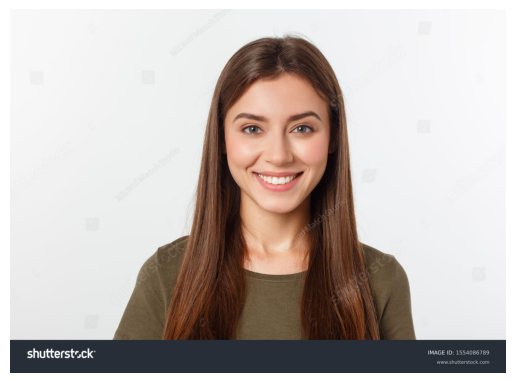

1it [00:00,  2.04it/s]

images:fh.jpg, output:['male_happy']


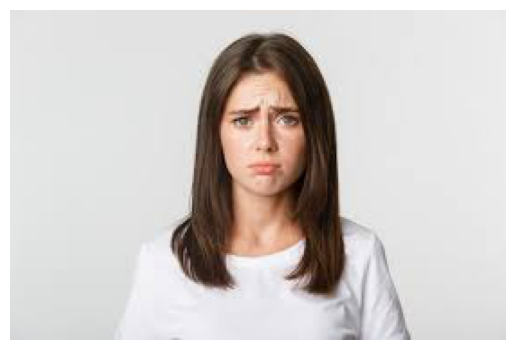

images:fs.jpeg, output:['male_happy']


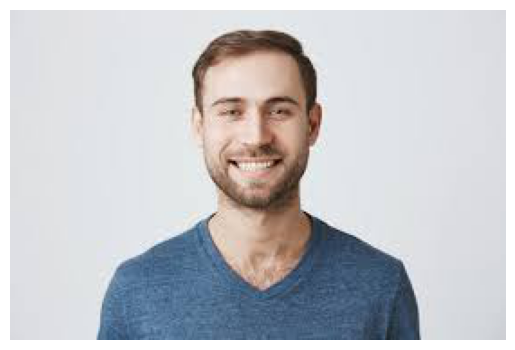

3it [00:00,  5.35it/s]

images:mh.jpeg, output:['male_sad']


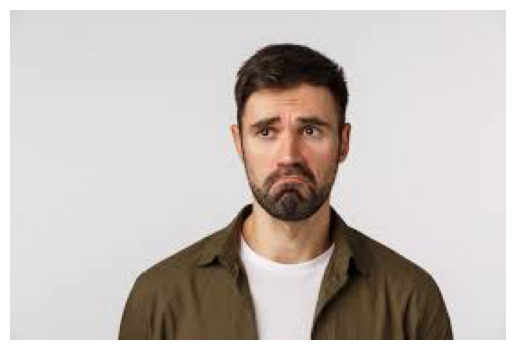

4it [00:00,  5.46it/s]

images:ms.jpeg, output:['male_sad']


In [50]:
test = ['fh.jpg','fs.jpeg','mh.jpeg','ms.jpeg']
for i,images in tqdm(enumerate(test)):
    output= decode_gender_emotion(label_encoder,gender_emotion_model1,images)
    print(f"images:{images}, output:{output}")

### Model 2 wtih Dropout Layers

Two callbacks are introduced: EarlyStopping and ModelCheckpoint.

same input shape (64, 64, 3)

dropout_layers=2 - two dropout layers will be added to the model during construction.


In [51]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('M2_best_model.keras', monitor='val_loss', save_best_only=True)
gender_emotion_model2=CNN_Model((64,64,3),4,2)
gender_emotion_model2.summary()

Dropout Layers:2
Learning Rate:0.001
CL1
AP1
DO1,1
CL2
AP2
DO2,0
CL3
Flatten
Dense1
Dense2
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 60, 60, 6)         456       
                                                                 
 average_pooling2d_4 (Avera  (None, 30, 30, 6)         0         
 gePooling2D)                                                    
                                                                 
 dropout (Dropout)           (None, 30, 30, 6)         0         
                                                                 
 conv2d_7 (Conv2D)           (None, 26, 26, 16)        2416      
                                                                 
 average_pooling2d_5 (Avera  (None, 13, 13, 16)        0         
 gePooling2D)                                                    
                             

In [52]:
%%time
history_GE2 = gender_emotion_model2.fit(
    X_train_gender, new_y_train_gender_encoded,
    epochs=50,  # Increased epochs due to early stopping
    batch_size=32,
    validation_data=(X_test_gender, new_y_test_gender_encoded),
    callbacks=[early_stopping, model_checkpoint]
)

Epoch 1/50
1470/1470 [==============================] - 45s 30ms/step - loss: 0.6822 - accuracy: 0.7307 - val_loss: 0.5650 - val_accuracy: 0.7693
Epoch 2/50
1470/1470 [==============================] - 40s 27ms/step - loss: 0.5321 - accuracy: 0.7916 - val_loss: 0.4563 - val_accuracy: 0.8236
Epoch 3/50
1470/1470 [==============================] - 40s 27ms/step - loss: 0.5331 - accuracy: 0.7876 - val_loss: 0.5325 - val_accuracy: 0.7893
Epoch 4/50
1470/1470 [==============================] - 40s 27ms/step - loss: 0.5741 - accuracy: 0.7712 - val_loss: 0.5051 - val_accuracy: 0.8024
Epoch 5/50
1470/1470 [==============================] - 41s 28ms/step - loss: 0.5599 - accuracy: 0.7767 - val_loss: 0.5515 - val_accuracy: 0.7822
Epoch 6/50
1470/1470 [==============================] - 41s 28ms/step - loss: 0.5699 - accuracy: 0.7748 - val_loss: 0.4908 - val_accuracy: 0.8062
Epoch 7/50
1470/1470 [==============================] - 40s 27ms/step - loss: 0.5610 - accuracy: 0.7766 - val_loss: 0.4855 -

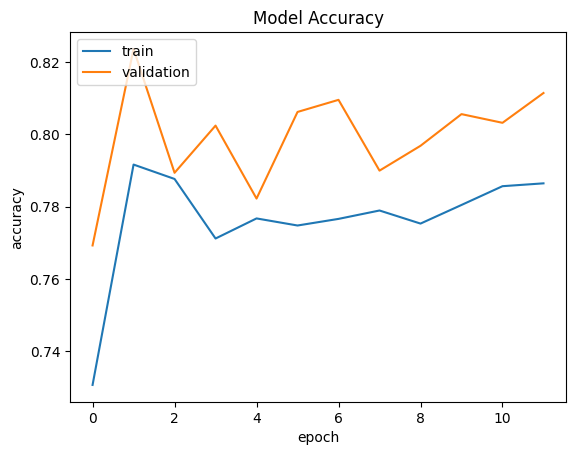

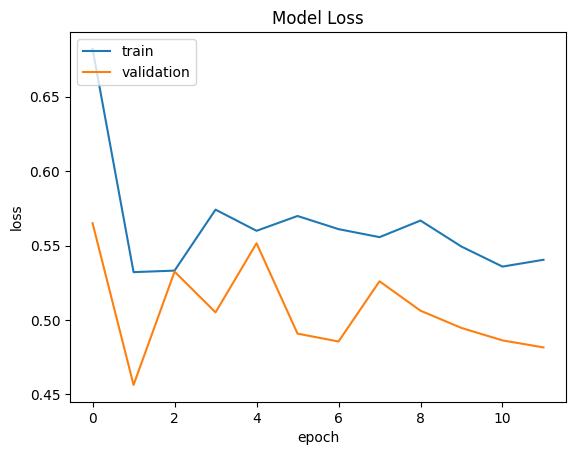

In [53]:
### we plot the validation and train accuracy and loss
plt.plot(history_GE2.history['accuracy'])
plt.plot(history_GE2.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

plt.plot(history_GE2.history['loss'])
plt.plot(history_GE2.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

0it [00:00, ?it/s]

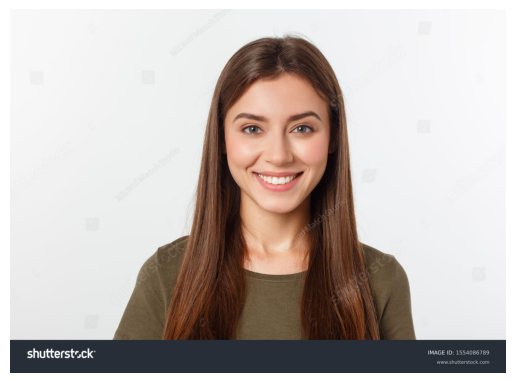

1it [00:00,  3.69it/s]

images:fh.jpg, output:['male_happy']


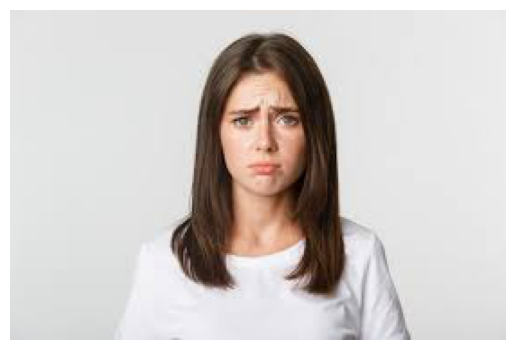

images:fs.jpeg, output:['male_happy']


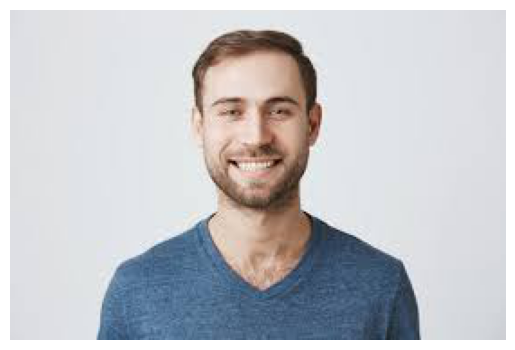

3it [00:00,  8.13it/s]

images:mh.jpeg, output:['male_sad']


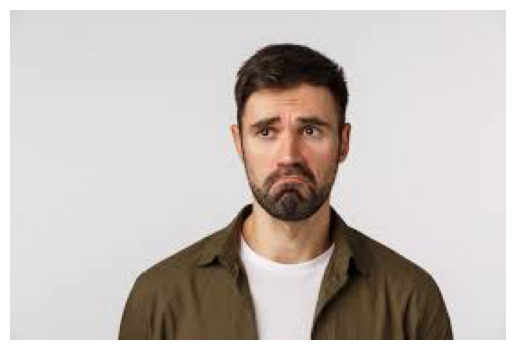

4it [00:00,  8.16it/s]

images:ms.jpeg, output:['male_sad']


In [54]:
test = ['fh.jpg','fs.jpeg','mh.jpeg','ms.jpeg']
for i,images in tqdm(enumerate(test)):
    output= decode_gender_emotion(label_encoder,gender_emotion_model2,images)
    print(f"images:{images}, output:{output}")

### Model 3 with dropout layers and class weights by balancing the dataset

#### Computing the Class weights for unbalanced gender dataset

In [55]:
from sklearn.utils.class_weight import compute_class_weight
integer_encoded = label_encoder.fit_transform(new_y_train_gender)
# Use the integer-encoded labels, not the one-hot encoded labels
classes = np.unique(integer_encoded)  # This should contain integers [0, 1, 2, 3] corresponding to your classes
class_weights = compute_class_weight(class_weight='balanced', classes=classes, y=integer_encoded)
class_weights_dict = {i: weight for i, weight in enumerate(class_weights)}

print(class_weights_dict)

{0: 0.8327251470275633, 1: 1.2872124863088719, 2: 1.585356805611763, 3: 0.7186601846755947}


In [56]:
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('M3_best_model.keras', monitor='val_loss', save_best_only=True)
gender_emotion_model3=CNN_Model((64,64,3),4,2)
gender_emotion_model3.summary()

Dropout Layers:2
Learning Rate:0.001
CL1
AP1
DO1,1
CL2
AP2
DO2,0
CL3
Flatten
Dense1
Dense2
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 60, 60, 6)         456       
                                                                 
 average_pooling2d_6 (Avera  (None, 30, 30, 6)         0         
 gePooling2D)                                                    
                                                                 
 dropout_2 (Dropout)         (None, 30, 30, 6)         0         
                                                                 
 conv2d_10 (Conv2D)          (None, 26, 26, 16)        2416      
                                                                 
 average_pooling2d_7 (Avera  (None, 13, 13, 16)        0         
 gePooling2D)                                                    
                             

In [57]:
%%time
history_GE3 = gender_emotion_model3.fit(
    X_train_gender, new_y_train_gender_encoded,
    epochs=50, batch_size=32,
    validation_data=(X_test_gender, new_y_test_gender_encoded),
    callbacks=[early_stopping, model_checkpoint],
    class_weight=class_weights_dict)

Epoch 1/50
1470/1470 [==============================] - 42s 28ms/step - loss: 0.7274 - accuracy: 0.7130 - val_loss: 0.5390 - val_accuracy: 0.7891
Epoch 2/50
1470/1470 [==============================] - 39s 26ms/step - loss: 0.5768 - accuracy: 0.7724 - val_loss: 0.5024 - val_accuracy: 0.8050
Epoch 3/50
1470/1470 [==============================] - 40s 27ms/step - loss: 0.5837 - accuracy: 0.7705 - val_loss: 0.5377 - val_accuracy: 0.7860
Epoch 4/50
1470/1470 [==============================] - 40s 27ms/step - loss: 0.6181 - accuracy: 0.7562 - val_loss: 0.6078 - val_accuracy: 0.7523
Epoch 5/50
1470/1470 [==============================] - 40s 28ms/step - loss: 0.6182 - accuracy: 0.7572 - val_loss: 0.5253 - val_accuracy: 0.7919
Epoch 6/50
1470/1470 [==============================] - 41s 28ms/step - loss: 0.6157 - accuracy: 0.7597 - val_loss: 0.5283 - val_accuracy: 0.7906
Epoch 7/50
1470/1470 [==============================] - 41s 28ms/step - loss: 0.6116 - accuracy: 0.7601 - val_loss: 0.5148 -

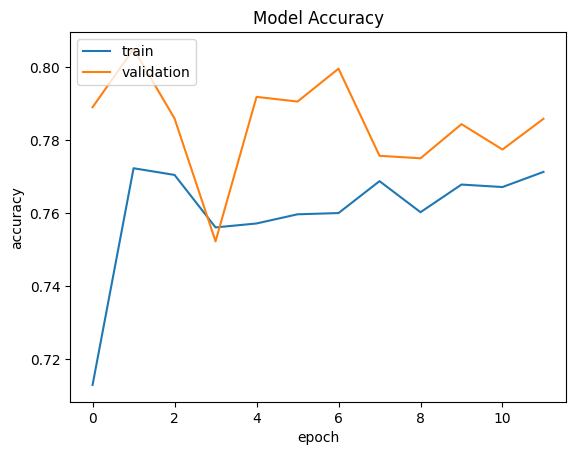

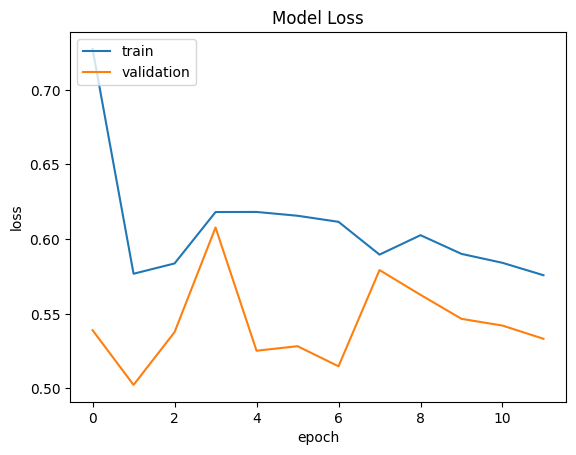

In [58]:
### we plot the validation and train accuracy and loss
plt.plot(history_GE3.history['accuracy'])
plt.plot(history_GE3.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

plt.plot(history_GE3.history['loss'])
plt.plot(history_GE3.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

0it [00:00, ?it/s]

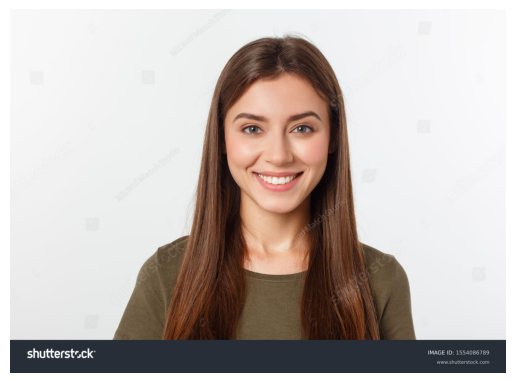

1it [00:00,  3.67it/s]

images:fh.jpg, output:['male_happy']


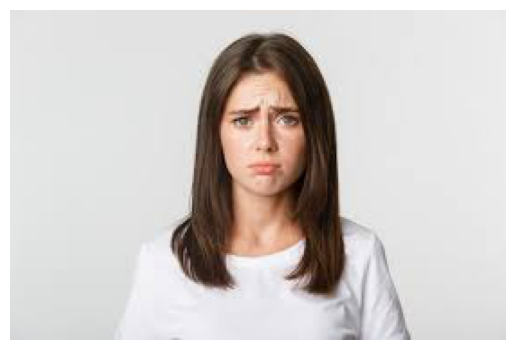

images:fs.jpeg, output:['male_happy']


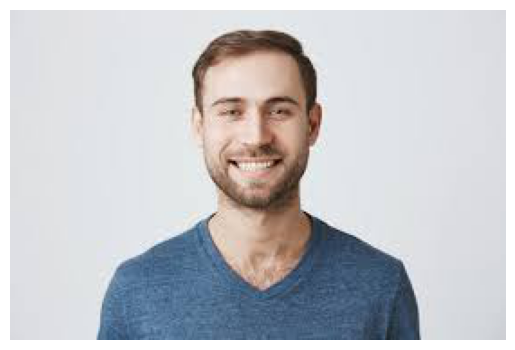

3it [00:00,  8.02it/s]

images:mh.jpeg, output:['male_happy']


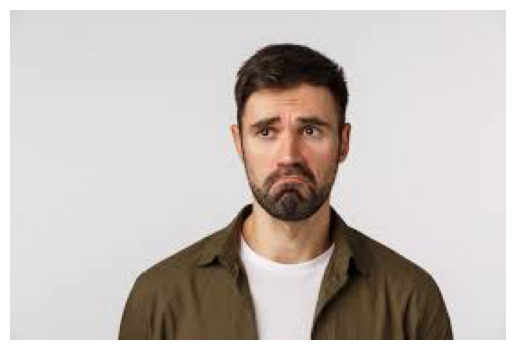

4it [00:00,  7.84it/s]

images:ms.jpeg, output:['male_sad']


In [59]:
test = ['fh.jpg','fs.jpeg','mh.jpeg','ms.jpeg']
for i,images in tqdm(enumerate(test)):
    output= decode_gender_emotion(label_encoder,gender_emotion_model3,images)
    print(f"images:{images}, output:{output}")

### Model 4 with dropout layers, undersampling classes

#### Undersampling the majority classes

In [60]:
import numpy as np
import pandas as pd
from sklearn.utils import resample

# Assuming X_train_gender and y_train_gender are your initial datasets
# Convert them into a DataFrame for easier manipulation
def undersample(x,y):
    

    df = pd.DataFrame({
        'images': list(x),
        'labels': y
    })

    # Find the smallest class size
    min_class_size = df['labels'].value_counts().min()

    # Perform undersampling
    undersampled_dfs = []
    for label in df['labels'].unique():
        label_df = df[df['labels'] == label]
        undersampled_label_df = resample(label_df,
                                         replace=False,  # sample without replacement
                                         n_samples=min_class_size,  # match minority n
                                         random_state=123)  # reproducible results
        undersampled_dfs.append(undersampled_label_df)

    # Concatenate the undersampled dataframes back into a single dataframe
    undersampled_df = pd.concat(undersampled_dfs)

    # # Extract the undersampled arrays and labels
    x_undersampled = np.array(list(undersampled_df['images']))
    y_undersampled = undersampled_df['labels'].values
    return x_undersampled,y_undersampled
    
X_train_gender_downsample,y_train_gender_downsample=undersample(X_train_gender,new_y_train_gender)

{'female_happy': 7413, 'female_sad': 7413, 'male_happy': 7413, 'male_sad': 7413}
Value: female_happy, Count: 7413, Percentage: 25.00%
Value: female_sad, Count: 7413, Percentage: 25.00%
Value: male_happy, Count: 7413, Percentage: 25.00%
Value: male_sad, Count: 7413, Percentage: 25.00%


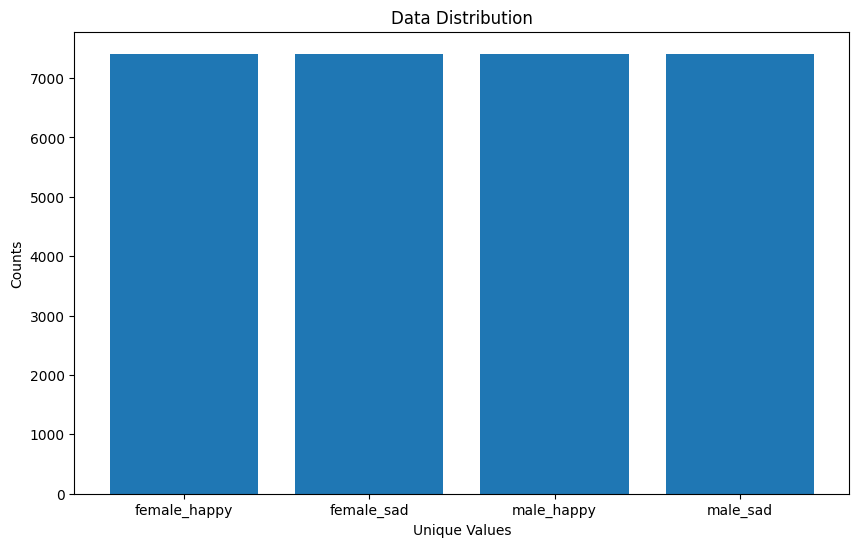

In [61]:
data_distribution(y_train_gender_downsample)

In [62]:
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical

#Training
y_train_gender_downsampled_encoded = encoding(y_train_gender_downsample,label_encoder)

In [63]:
print("Training data shape:", X_train_gender_downsample.shape)
print("Training labels shape:", y_train_gender_downsampled_encoded.shape)
print("Test data shape:", X_test_gender.shape)
print("Test labels shape:", new_y_test_gender_encoded.shape)


Training data shape: (29652, 64, 64, 3)
Training labels shape: (29652, 4)
Test data shape: (11649, 64, 64, 3)
Test labels shape: (11649, 4)


#### Model 4

In [64]:
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('M4_best_model.keras', monitor='val_loss', save_best_only=True)
gender_emotion_model4=CNN_Model((64,64,3),4,2)
gender_emotion_model4.summary()

Dropout Layers:2
Learning Rate:0.001
CL1
AP1
DO1,1
CL2
AP2
DO2,0
CL3
Flatten
Dense1
Dense2
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 60, 60, 6)         456       
                                                                 
 average_pooling2d_8 (Avera  (None, 30, 30, 6)         0         
 gePooling2D)                                                    
                                                                 
 dropout_4 (Dropout)         (None, 30, 30, 6)         0         
                                                                 
 conv2d_13 (Conv2D)          (None, 26, 26, 16)        2416      
                                                                 
 average_pooling2d_9 (Avera  (None, 13, 13, 16)        0         
 gePooling2D)                                                    
                             

In [65]:
%%time
history_GE4 = gender_emotion_model4.fit(
    X_train_gender_downsample, y_train_gender_downsampled_encoded,
    epochs=25, batch_size=32,
    validation_data=(X_test_gender, new_y_test_gender_encoded),
    callbacks=[early_stopping, model_checkpoint])

Epoch 1/25
927/927 [==============================] - 27s 28ms/step - loss: 0.8229 - accuracy: 0.6681 - val_loss: 0.5339 - val_accuracy: 0.7937
Epoch 2/25
927/927 [==============================] - 25s 27ms/step - loss: 0.5970 - accuracy: 0.7637 - val_loss: 0.5016 - val_accuracy: 0.8067
Epoch 3/25
927/927 [==============================] - 26s 28ms/step - loss: 0.5439 - accuracy: 0.7831 - val_loss: 0.4649 - val_accuracy: 0.8227
Epoch 4/25
927/927 [==============================] - 26s 28ms/step - loss: 0.5469 - accuracy: 0.7830 - val_loss: 0.5397 - val_accuracy: 0.7843
Epoch 5/25
927/927 [==============================] - 27s 29ms/step - loss: 0.5565 - accuracy: 0.7773 - val_loss: 0.4862 - val_accuracy: 0.8148
Epoch 6/25
927/927 [==============================] - 27s 29ms/step - loss: 0.5818 - accuracy: 0.7664 - val_loss: 0.5216 - val_accuracy: 0.7946
Epoch 7/25
927/927 [==============================] - 26s 28ms/step - loss: 0.5908 - accuracy: 0.7612 - val_loss: 0.5432 - val_accuracy:

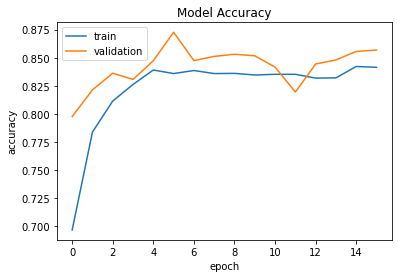

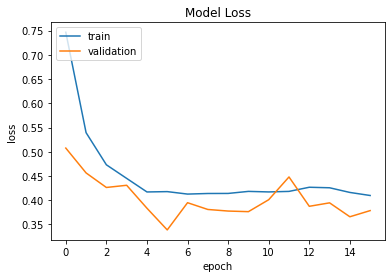

In [53]:
### we plot the validation and train accuracy and loss
plt.plot(history_GE4.history['accuracy'])
plt.plot(history_GE4.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

plt.plot(history_GE4.history['loss'])
plt.plot(history_GE4.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

0it [00:00, ?it/s]

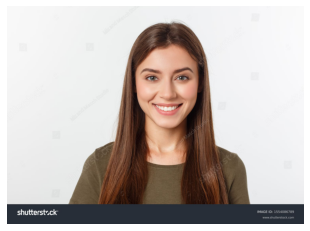

1it [00:00,  2.59it/s]

images:fh.jpg, output:['male_happy']


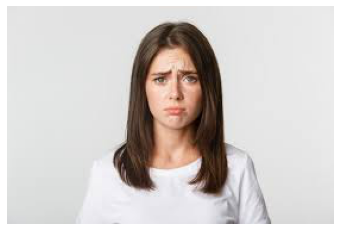

2it [00:00,  3.93it/s]

images:fs.jpeg, output:['male_happy']


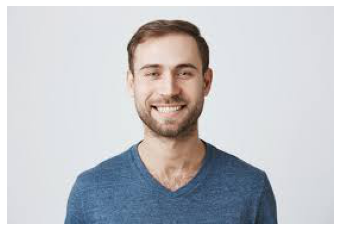

3it [00:00,  5.12it/s]

images:mh.jpeg, output:['male_sad']


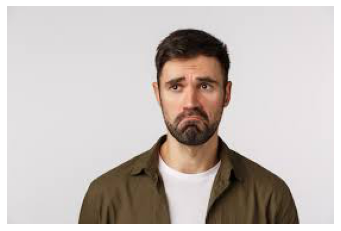

4it [00:00,  6.03it/s]

images:ms.jpeg, output:['male_sad']


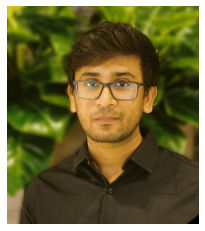

5it [00:00,  5.12it/s]

images:ch.png, output:['male_happy']


In [54]:
test = ['fh.jpg','fs.jpeg','mh.jpeg','ms.jpeg']
for i,images in tqdm(enumerate(test)):
    output= decode_gender_emotion(label_encoder,gender_emotion_model4,images)
    print(f"images:{images}, output:{output}")

In [66]:
m1 = tf.keras.models.load_model('M1_model.keras')

In [67]:
m2 = tf.keras.models.load_model('M2_best_model.keras')

In [68]:
m3 = tf.keras.models.load_model('M3_best_model.keras')

In [69]:
m4 = tf.keras.models.load_model('M4_best_model.keras')

### Lets test all of our models now

In [70]:
# List all files in the folder
def output_testing(model,folder_path):
    image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

    for i,images in tqdm(enumerate(image_files), total=len(image_files)):
        # Construct the full image path
        image_path = os.path.join(folder_path, images)
        output= decode_gender_emotion(label_encoder,model,image_path)
        print(f"images:{image_path}, output:{output}")

  0%|                                                    | 0/40 [00:00<?, ?it/s]

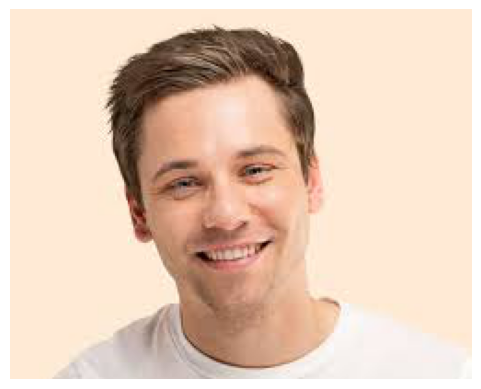

  2%|█                                           | 1/40 [00:01<00:42,  1.09s/it]

images:./test/ml-2.jpg, output:['male_happy']


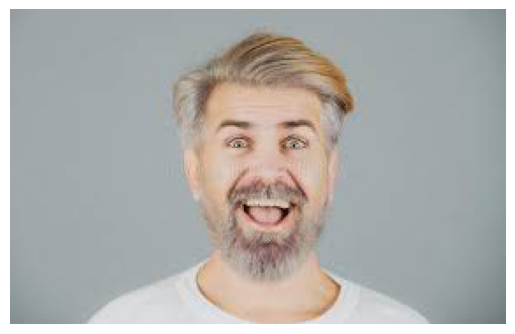

images:./test/ml-3.jpg, output:['male_happy']


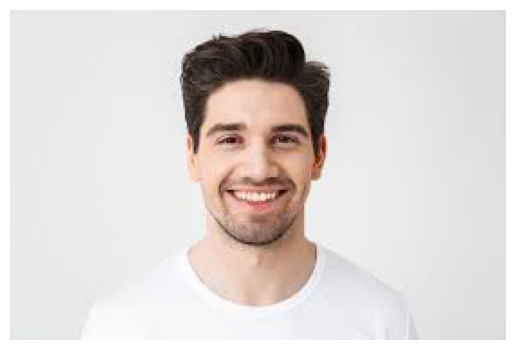

  8%|███▎                                        | 3/40 [00:01<00:12,  2.92it/s]

images:./test/ml-1.jpg, output:['male_happy']


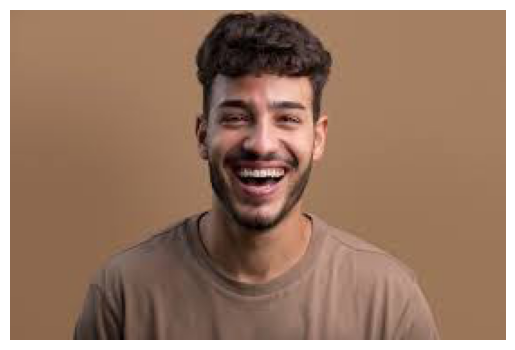

images:./test/ml-4.jpg, output:['male_sad']


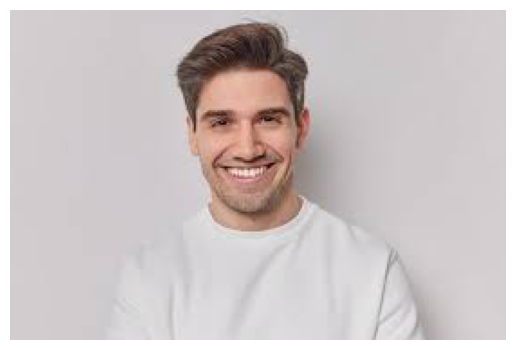

 12%|█████▌                                      | 5/40 [00:01<00:07,  4.76it/s]

images:./test/ml-5.jpg, output:['male_happy']


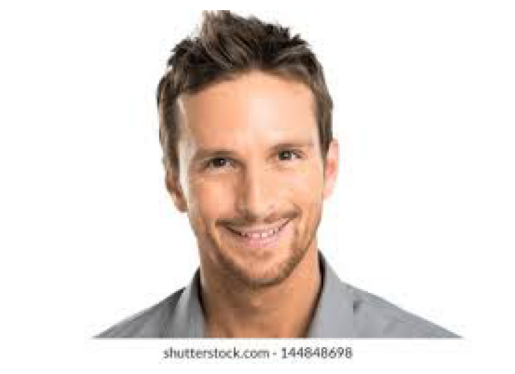

images:./test/ml-7.jpg, output:['male_happy']


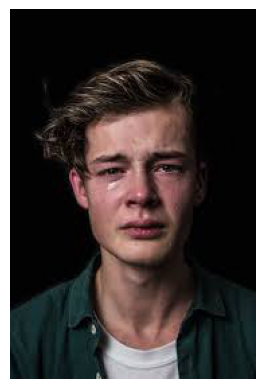

 18%|███████▋                                    | 7/40 [00:01<00:05,  6.48it/s]

images:./test/ml-s-10.jpg, output:['female_sad']


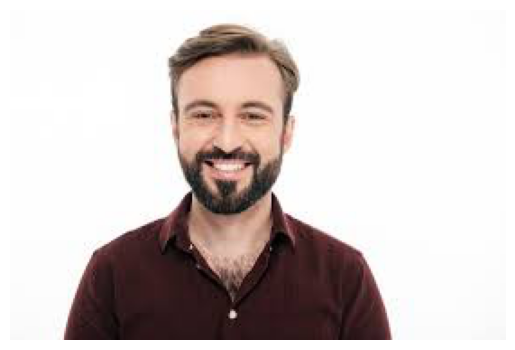

images:./test/ml-6.jpg, output:['male_happy']


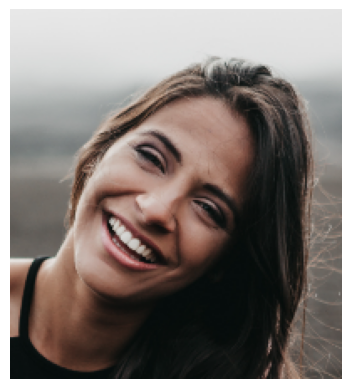

 22%|█████████▉                                  | 9/40 [00:01<00:03,  7.93it/s]

images:./test/fh4.png, output:['female_happy']


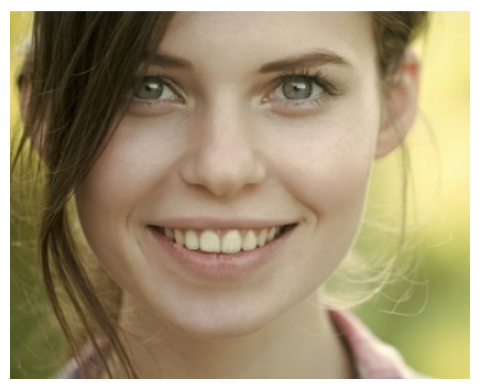

images:./test/fh5.png, output:['female_sad']


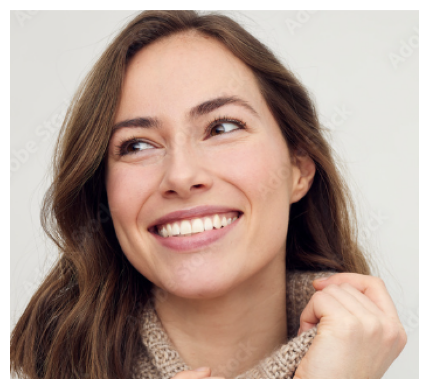

 28%|███████████▊                               | 11/40 [00:01<00:03,  7.93it/s]

images:./test/fh7.png, output:['female_sad']


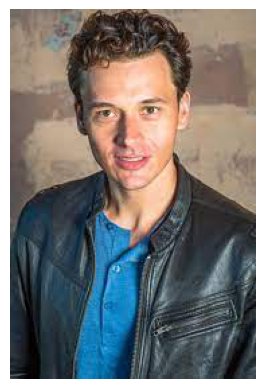

images:./test/ml-10.jpg, output:['male_sad']


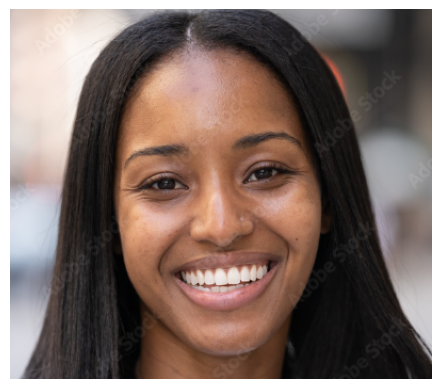

 32%|█████████████▉                             | 13/40 [00:02<00:03,  8.49it/s]

images:./test/fh10.png, output:['male_sad']


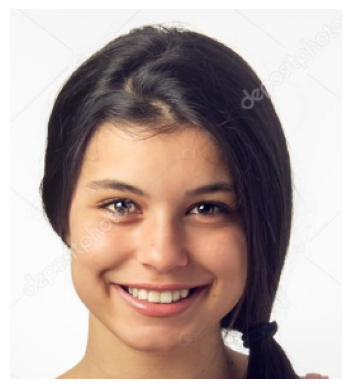

images:./test/fh6.png, output:['male_happy']


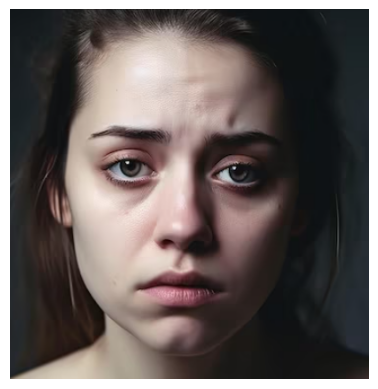

 38%|████████████████▏                          | 15/40 [00:02<00:02,  9.17it/s]

images:./test/fs10.png, output:['male_sad']


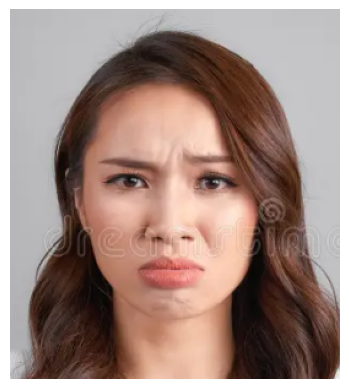

images:./test/fs8.png, output:['female_sad']


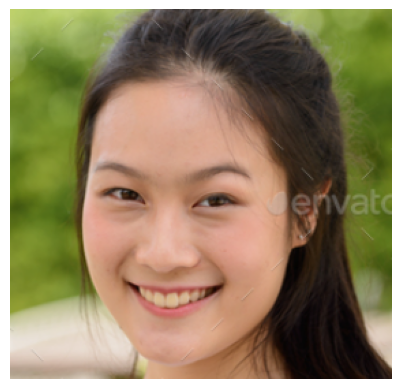

 42%|██████████████████▎                        | 17/40 [00:02<00:02,  9.35it/s]

images:./test/fh2.png, output:['male_sad']


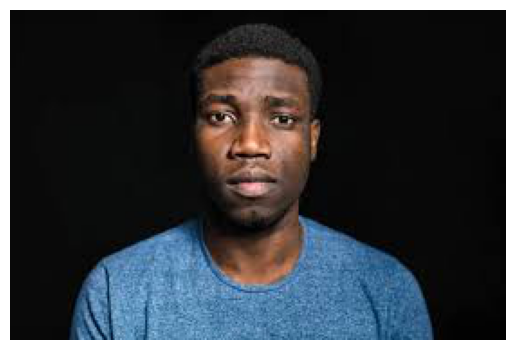

images:./test/ml-s-8.jpg, output:['male_sad']


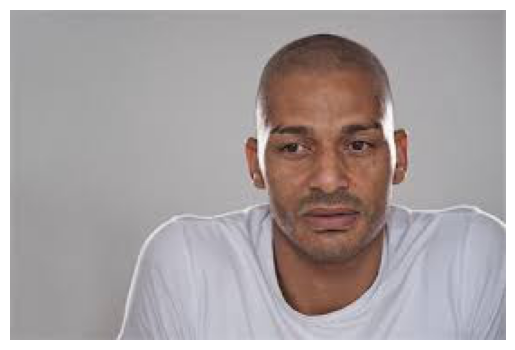

 48%|████████████████████▍                      | 19/40 [00:02<00:02, 10.32it/s]

images:./test/ml-s-9.jpg, output:['male_sad']


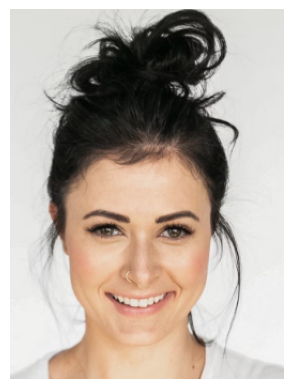

images:./test/fh3.png, output:['male_happy']


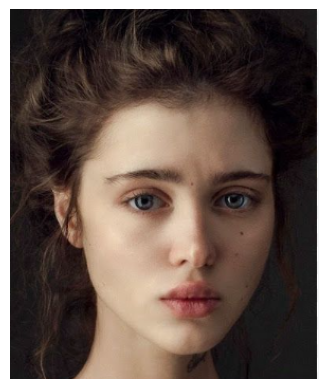

 52%|██████████████████████▌                    | 21/40 [00:02<00:01, 10.56it/s]

images:./test/fs9.png, output:['male_happy']


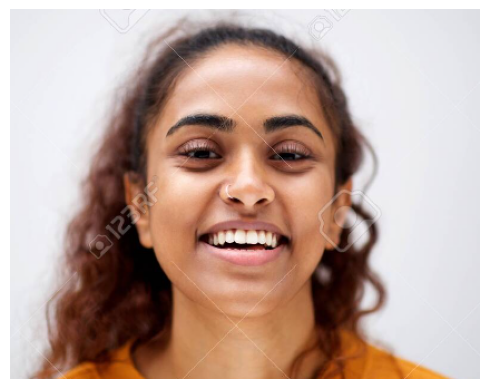

images:./test/fh1.png, output:['male_sad']


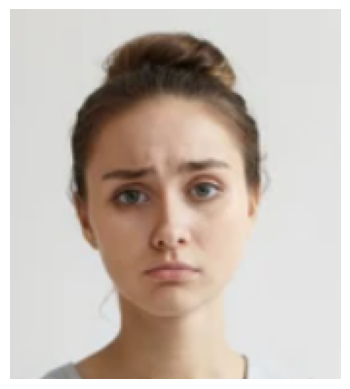

 57%|████████████████████████▋                  | 23/40 [00:03<00:01, 10.75it/s]

images:./test/fs7.png, output:['male_sad']


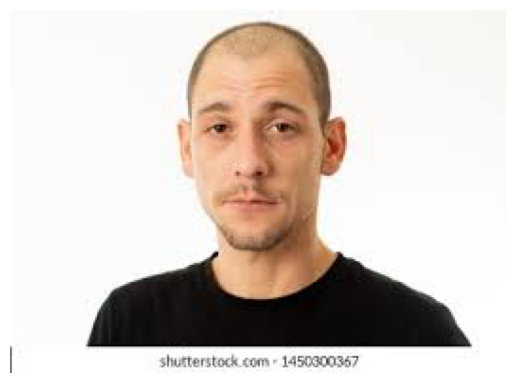

images:./test/ml-s-7.jpg, output:['male_sad']


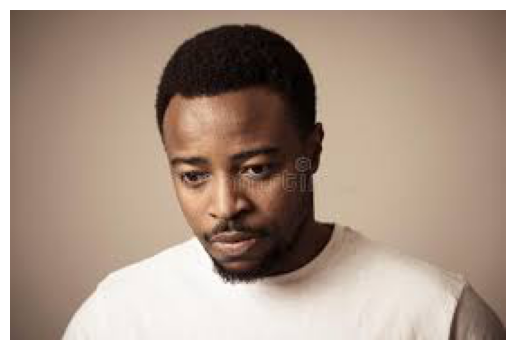

 62%|██████████████████████████▉                | 25/40 [00:03<00:01, 11.30it/s]

images:./test/ml-s-6.jpg, output:['male_happy']


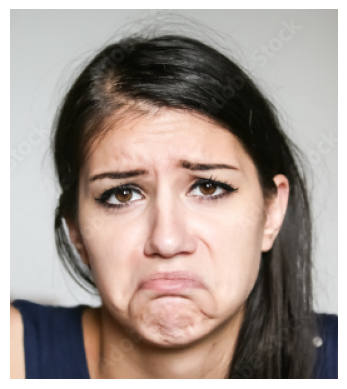

images:./test/fs6.png, output:['male_sad']


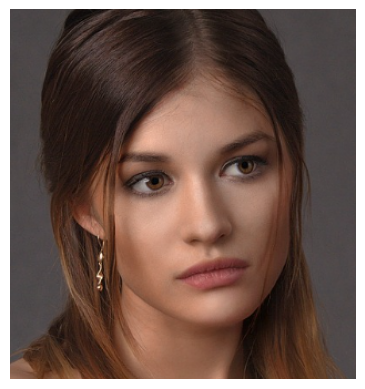

 68%|█████████████████████████████              | 27/40 [00:03<00:01, 10.80it/s]

images:./test/fs4.png, output:['female_sad']


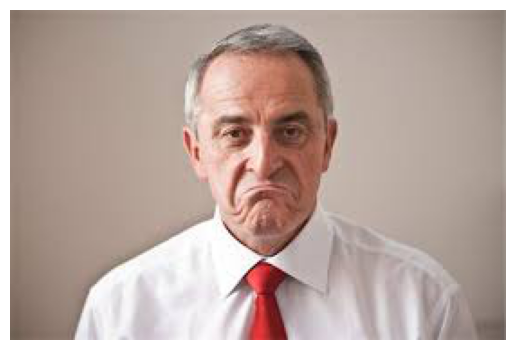

images:./test/ml-s-4.jpg, output:['male_happy']


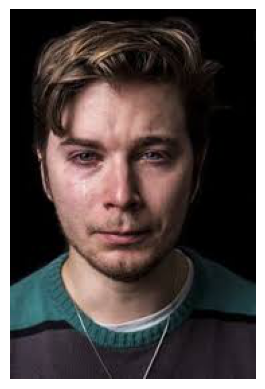

 72%|███████████████████████████████▏           | 29/40 [00:03<00:01, 10.91it/s]

images:./test/ml-s-5.jpg, output:['female_happy']


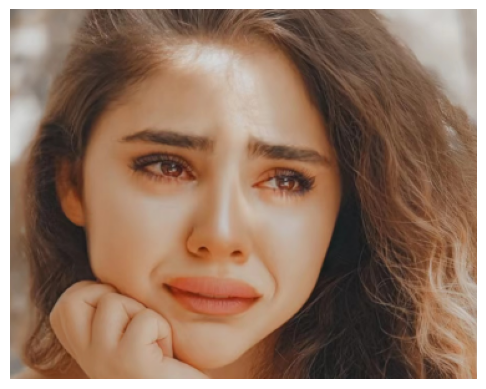

images:./test/fs5.png, output:['male_sad']


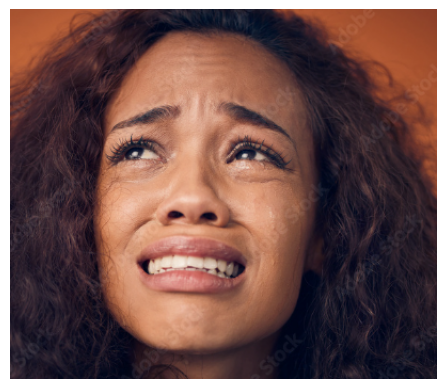

 78%|█████████████████████████████████▎         | 31/40 [00:03<00:00,  9.27it/s]

images:./test/fs1.png, output:['male_happy']


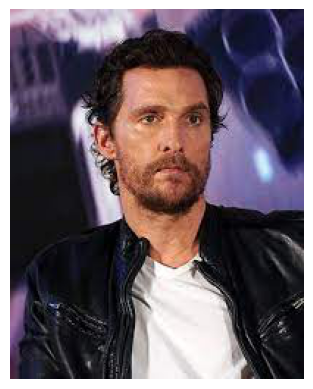

images:./test/ml-s-1.jpg, output:['male_happy']


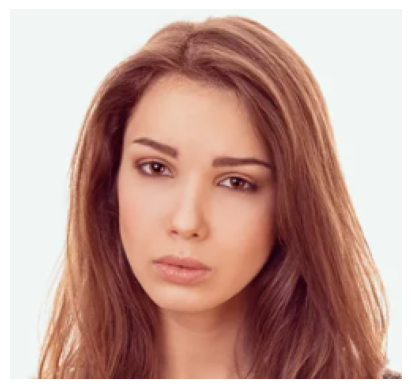

 82%|███████████████████████████████████▍       | 33/40 [00:04<00:00,  9.76it/s]

images:./test/fs2.png, output:['female_sad']


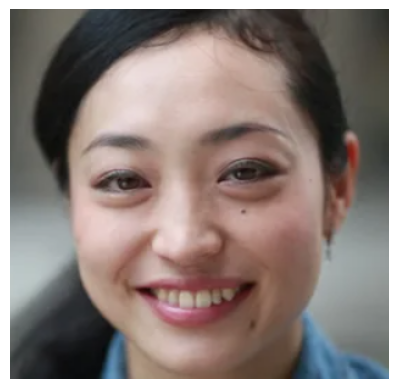

images:./test/fh8.png, output:['male_sad']


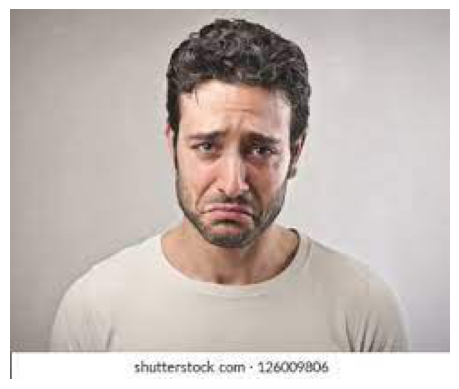

 88%|█████████████████████████████████████▋     | 35/40 [00:04<00:00,  9.94it/s]

images:./test/ml-s-2.jpg, output:['male_happy']


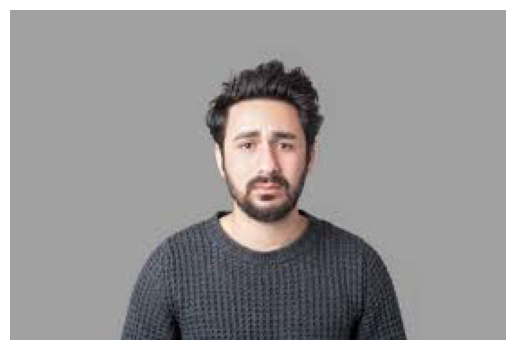

images:./test/ml-s-3.jpg, output:['male_happy']


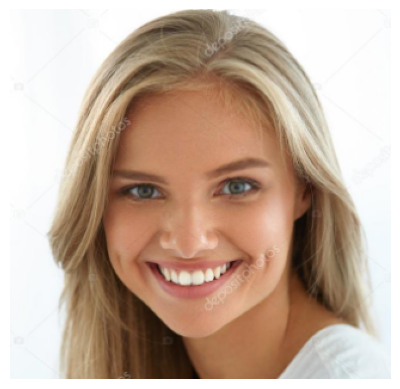

 92%|███████████████████████████████████████▊   | 37/40 [00:04<00:00, 10.31it/s]

images:./test/fh9.png, output:['female_sad']


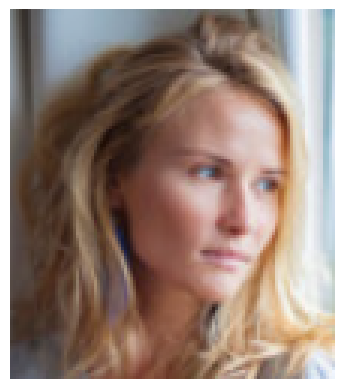

images:./test/fs3.png, output:['male_sad']


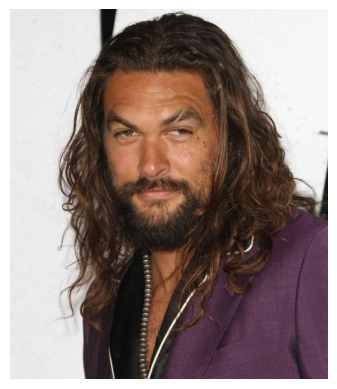

 98%|█████████████████████████████████████████▉ | 39/40 [00:04<00:00, 10.73it/s]

images:./test/ml-8.jpg, output:['female_sad']


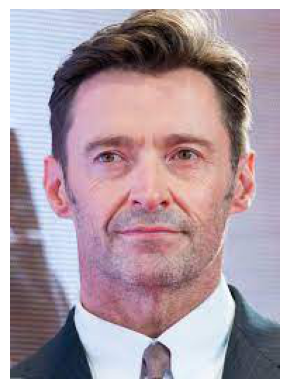

100%|███████████████████████████████████████████| 40/40 [00:04<00:00,  8.47it/s]

images:./test/ml-9.jpg, output:['male_happy']


In [71]:
output_testing(m1,"./test/")

  0%|                                                    | 0/40 [00:00<?, ?it/s]

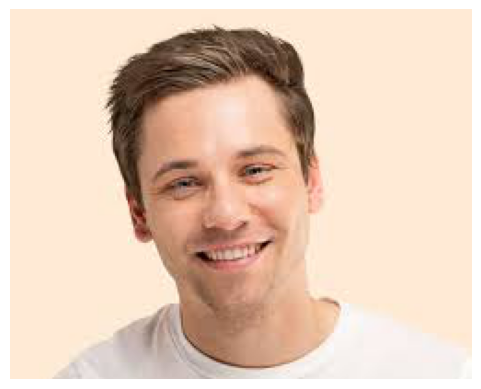

  2%|█                                           | 1/40 [00:00<00:05,  7.38it/s]

images:./test/ml-2.jpg, output:['male_happy']


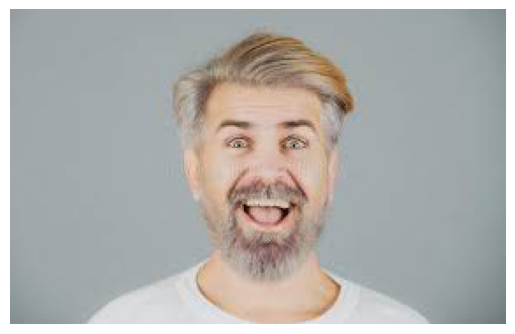

images:./test/ml-3.jpg, output:['male_happy']


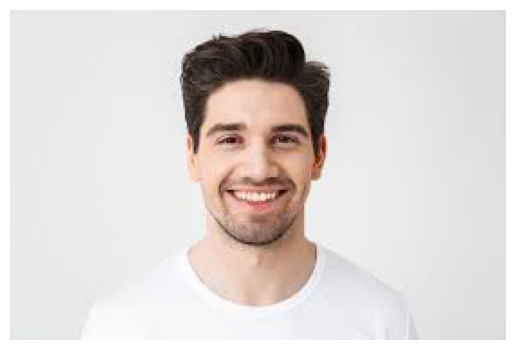

  8%|███▎                                        | 3/40 [00:00<00:03, 11.51it/s]

images:./test/ml-1.jpg, output:['male_happy']


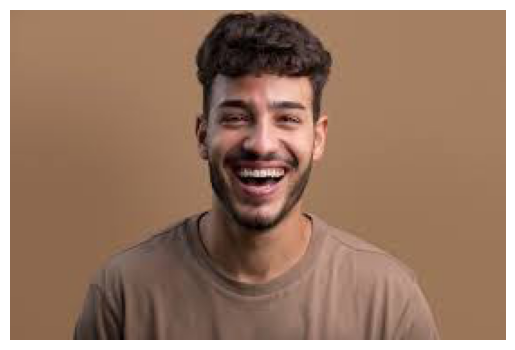

images:./test/ml-4.jpg, output:['male_sad']


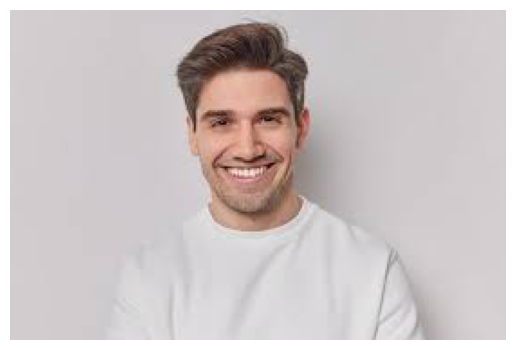

 12%|█████▌                                      | 5/40 [00:00<00:02, 12.69it/s]

images:./test/ml-5.jpg, output:['male_happy']


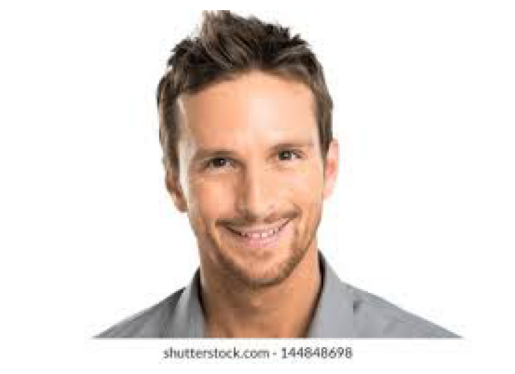

images:./test/ml-7.jpg, output:['male_happy']


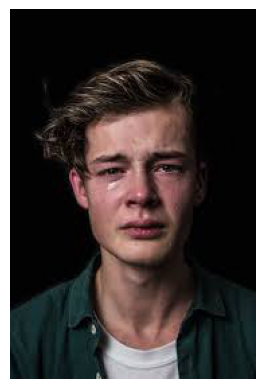

 18%|███████▋                                    | 7/40 [00:00<00:02, 13.31it/s]

images:./test/ml-s-10.jpg, output:['female_sad']


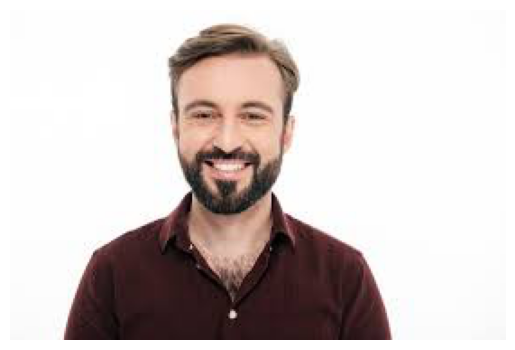

images:./test/ml-6.jpg, output:['male_happy']


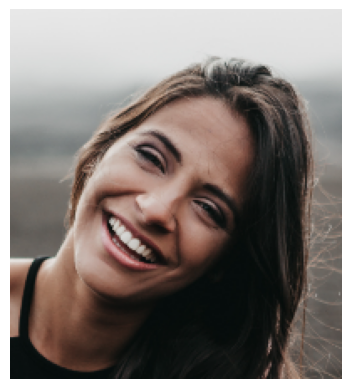

 22%|█████████▉                                  | 9/40 [00:00<00:02, 13.04it/s]

images:./test/fh4.png, output:['male_happy']


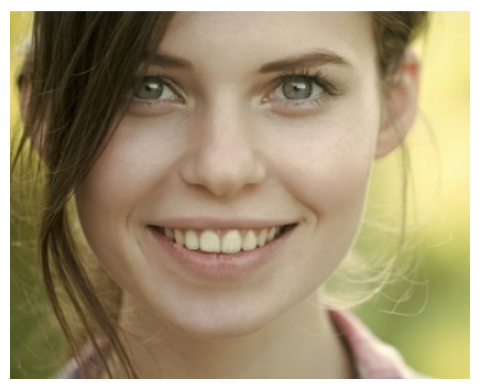

images:./test/fh5.png, output:['female_sad']


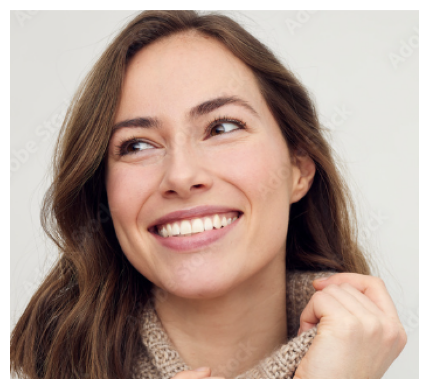

 28%|███████████▊                               | 11/40 [00:00<00:02, 11.15it/s]

images:./test/fh7.png, output:['female_sad']


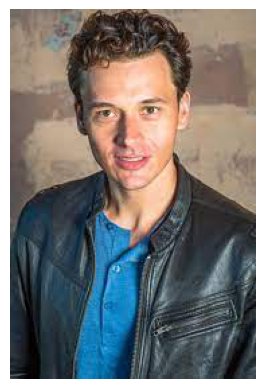

images:./test/ml-10.jpg, output:['male_sad']


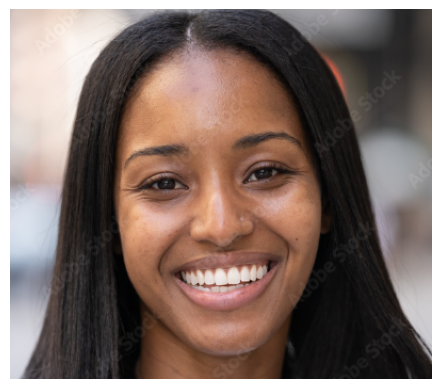

 32%|█████████████▉                             | 13/40 [00:01<00:02, 10.75it/s]

images:./test/fh10.png, output:['male_sad']


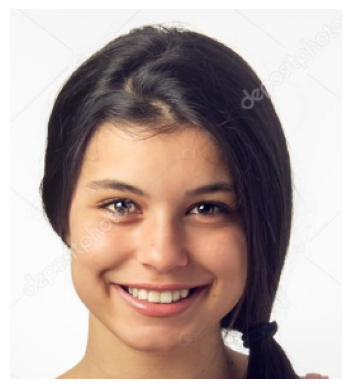

images:./test/fh6.png, output:['male_sad']


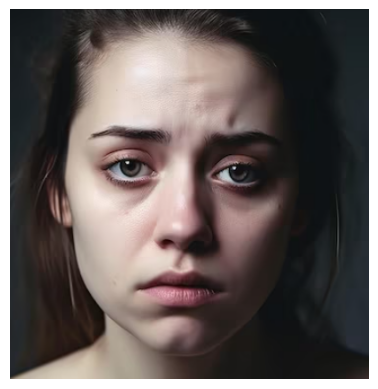

 38%|████████████████▏                          | 15/40 [00:01<00:02, 10.85it/s]

images:./test/fs10.png, output:['male_sad']


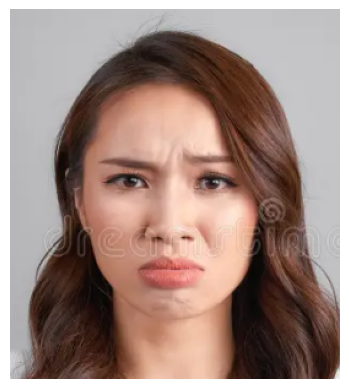

images:./test/fs8.png, output:['female_sad']


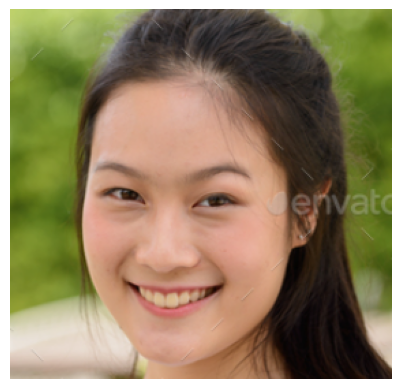

 42%|██████████████████▎                        | 17/40 [00:01<00:02, 10.62it/s]

images:./test/fh2.png, output:['male_happy']


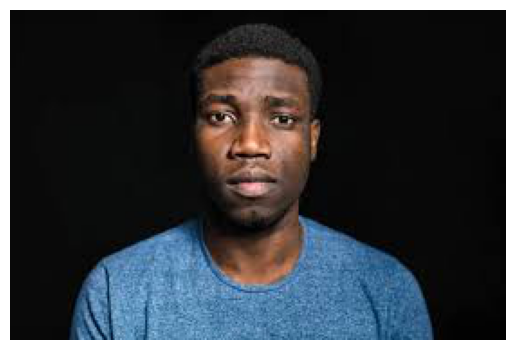

images:./test/ml-s-8.jpg, output:['male_sad']


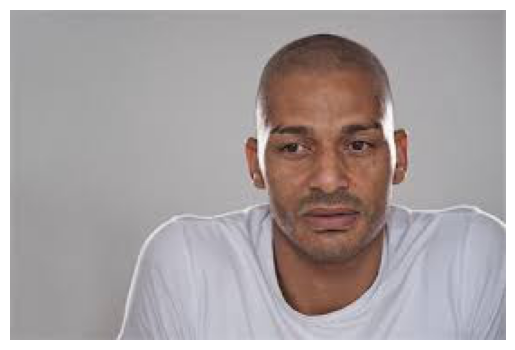

 48%|████████████████████▍                      | 19/40 [00:01<00:01, 11.47it/s]

images:./test/ml-s-9.jpg, output:['male_happy']


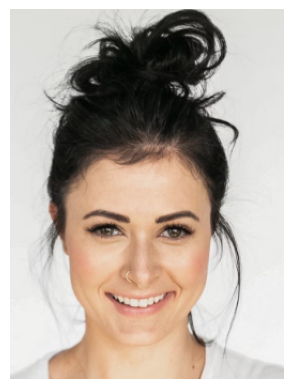

images:./test/fh3.png, output:['male_sad']


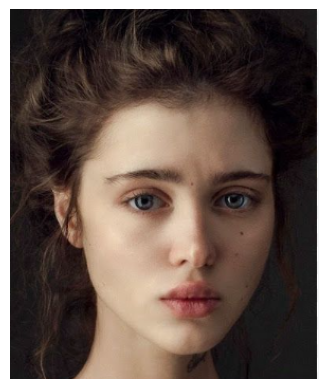

 52%|██████████████████████▌                    | 21/40 [00:01<00:01, 11.20it/s]

images:./test/fs9.png, output:['female_happy']


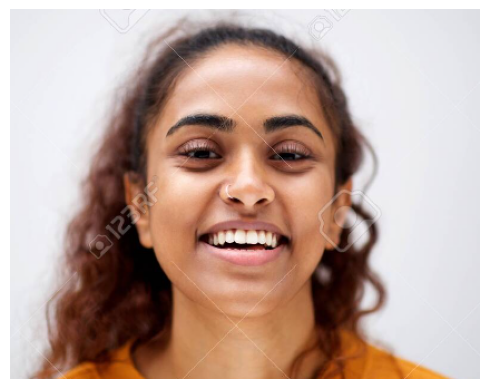

images:./test/fh1.png, output:['male_happy']


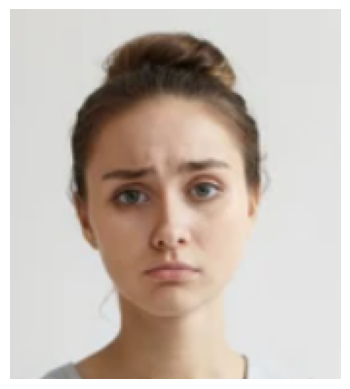

 57%|████████████████████████▋                  | 23/40 [00:02<00:01, 11.16it/s]

images:./test/fs7.png, output:['female_sad']


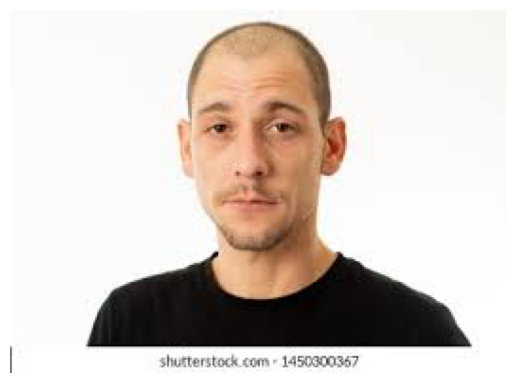

images:./test/ml-s-7.jpg, output:['male_sad']


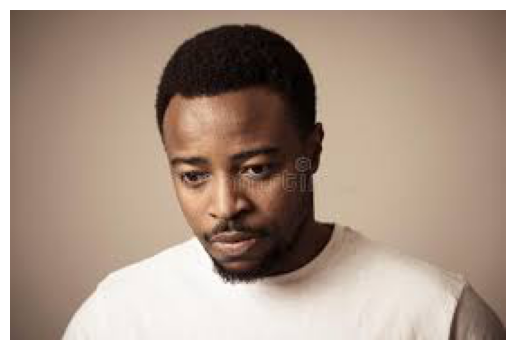

 62%|██████████████████████████▉                | 25/40 [00:02<00:01, 11.73it/s]

images:./test/ml-s-6.jpg, output:['male_happy']


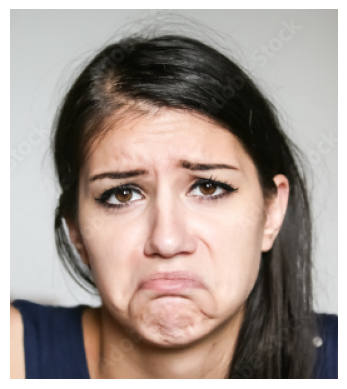

images:./test/fs6.png, output:['female_sad']


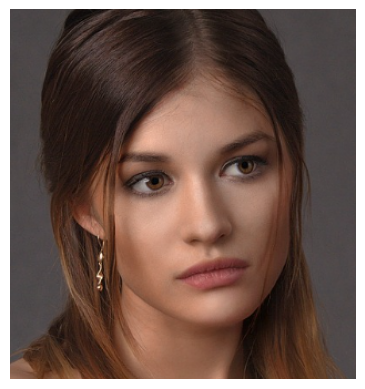

 68%|█████████████████████████████              | 27/40 [00:02<00:01, 10.86it/s]

images:./test/fs4.png, output:['male_sad']


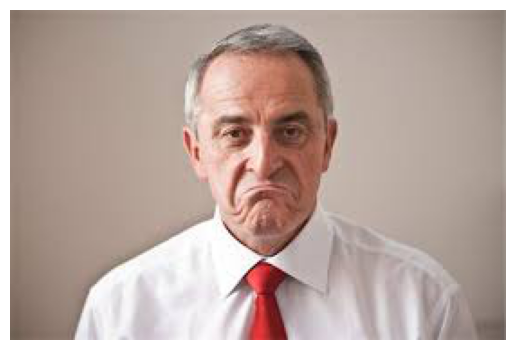

images:./test/ml-s-4.jpg, output:['male_happy']


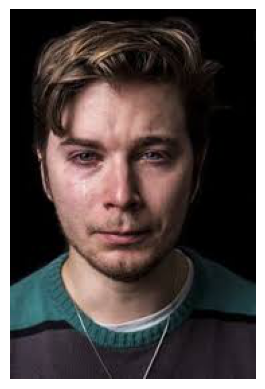

 72%|███████████████████████████████▏           | 29/40 [00:02<00:00, 11.35it/s]

images:./test/ml-s-5.jpg, output:['female_happy']


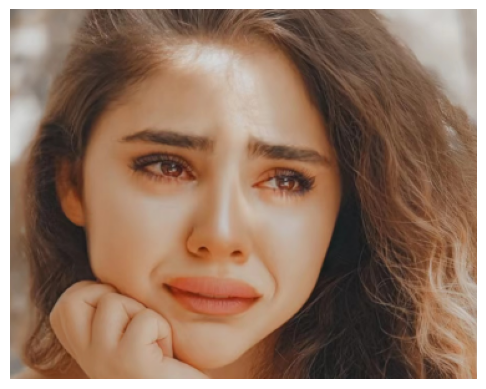

images:./test/fs5.png, output:['female_sad']


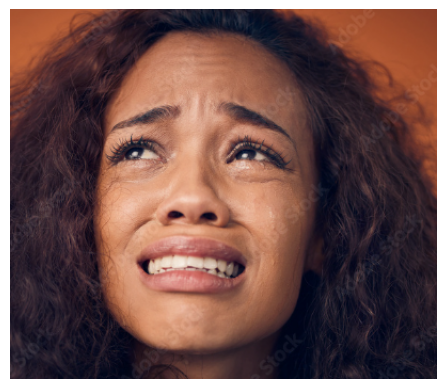

 78%|█████████████████████████████████▎         | 31/40 [00:02<00:00,  9.85it/s]

images:./test/fs1.png, output:['male_happy']


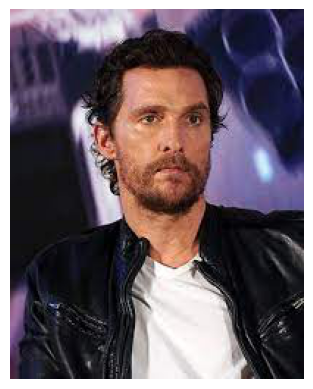

images:./test/ml-s-1.jpg, output:['male_sad']


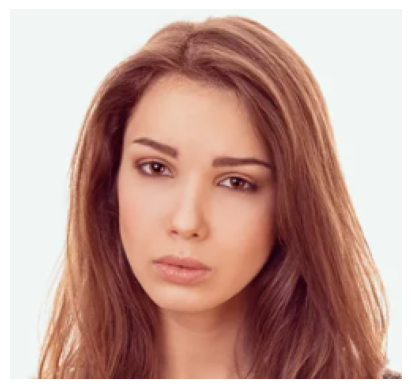

 82%|███████████████████████████████████▍       | 33/40 [00:02<00:00, 10.44it/s]

images:./test/fs2.png, output:['female_sad']


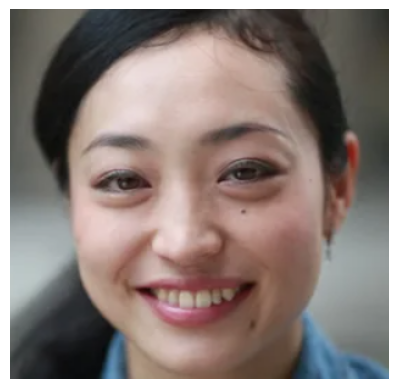

images:./test/fh8.png, output:['male_sad']


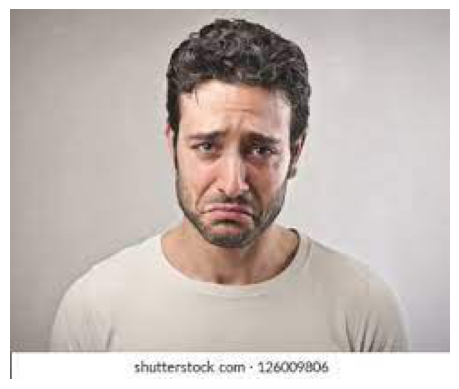

 88%|█████████████████████████████████████▋     | 35/40 [00:03<00:00, 10.66it/s]

images:./test/ml-s-2.jpg, output:['male_happy']


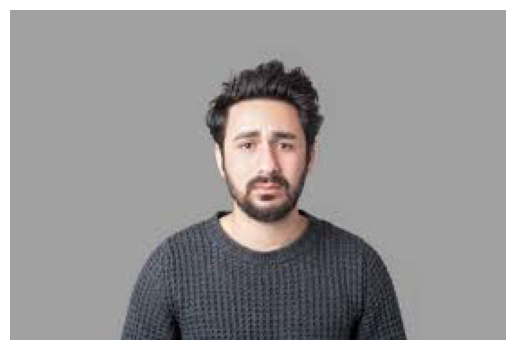

images:./test/ml-s-3.jpg, output:['male_happy']


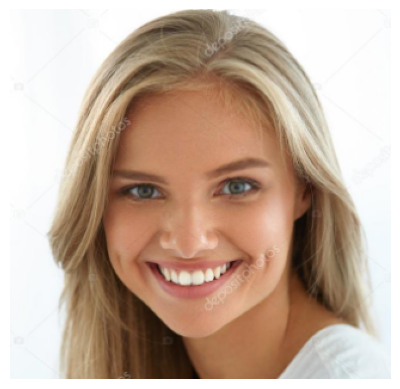

 92%|███████████████████████████████████████▊   | 37/40 [00:03<00:00, 11.08it/s]

images:./test/fh9.png, output:['male_sad']


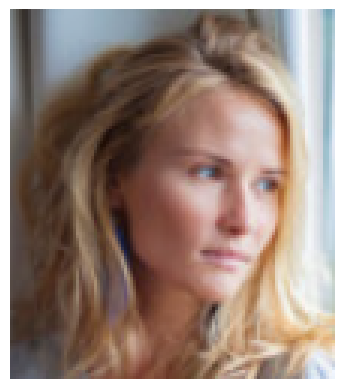

images:./test/fs3.png, output:['male_sad']


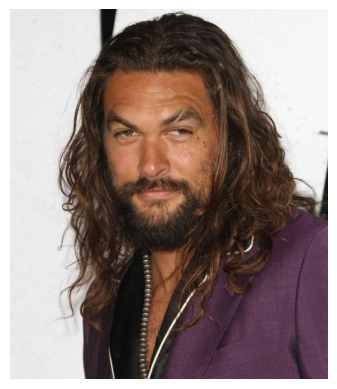

 98%|█████████████████████████████████████████▉ | 39/40 [00:03<00:00, 11.36it/s]

images:./test/ml-8.jpg, output:['male_sad']


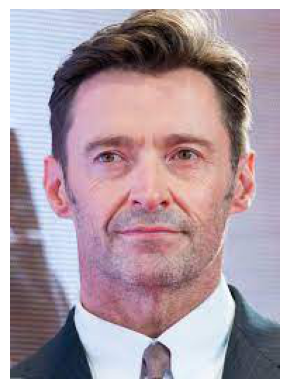

100%|███████████████████████████████████████████| 40/40 [00:03<00:00, 11.19it/s]

images:./test/ml-9.jpg, output:['male_happy']


In [72]:
output_testing(m2,"./test/")

  0%|                                                    | 0/40 [00:00<?, ?it/s]

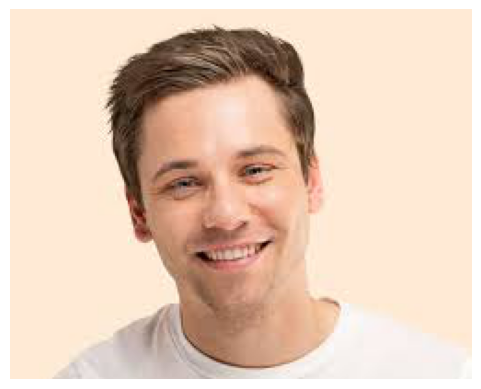

  2%|█                                           | 1/40 [00:00<00:04,  8.27it/s]

images:./test/ml-2.jpg, output:['male_happy']


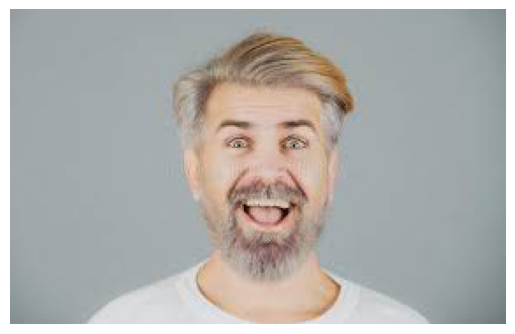

images:./test/ml-3.jpg, output:['male_happy']


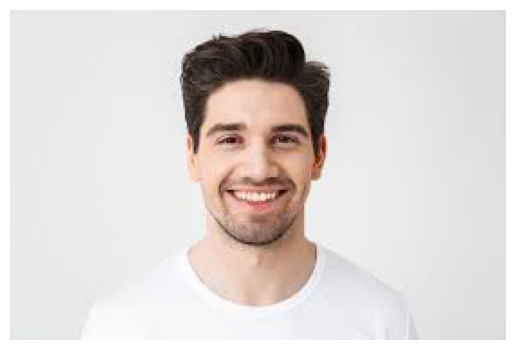

  8%|███▎                                        | 3/40 [00:00<00:03, 11.11it/s]

images:./test/ml-1.jpg, output:['male_happy']


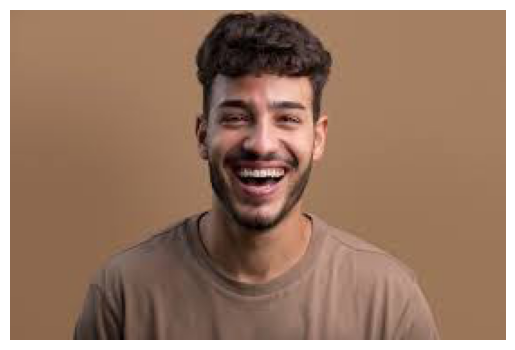

images:./test/ml-4.jpg, output:['male_sad']


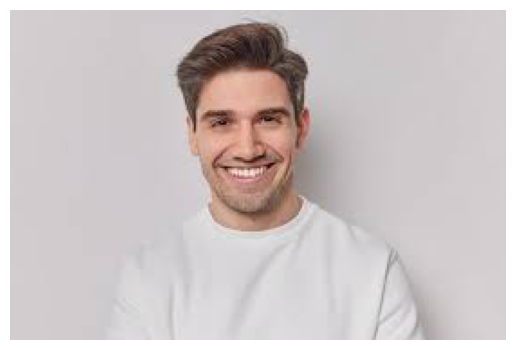

 12%|█████▌                                      | 5/40 [00:00<00:03, 11.48it/s]

images:./test/ml-5.jpg, output:['male_happy']


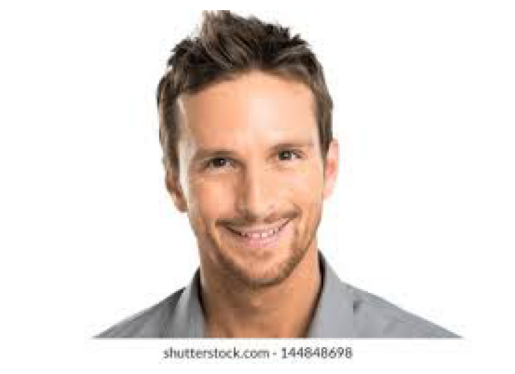

images:./test/ml-7.jpg, output:['male_happy']


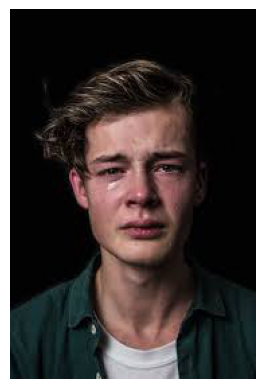

 18%|███████▋                                    | 7/40 [00:00<00:02, 11.95it/s]

images:./test/ml-s-10.jpg, output:['male_sad']


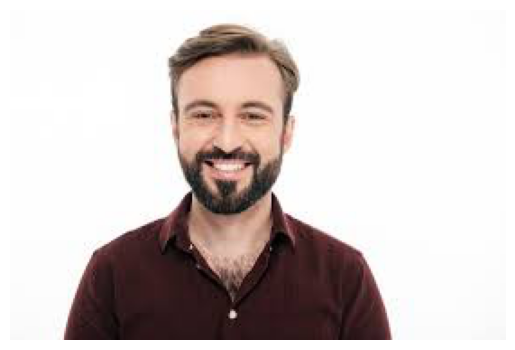

images:./test/ml-6.jpg, output:['male_happy']


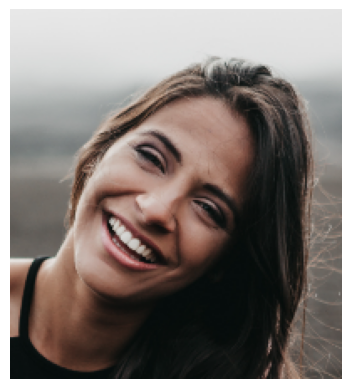

 22%|█████████▉                                  | 9/40 [00:00<00:02, 11.86it/s]

images:./test/fh4.png, output:['male_happy']


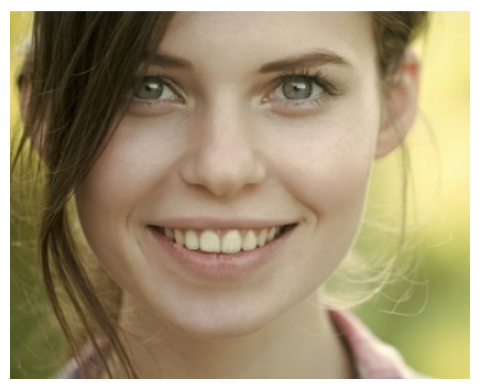

images:./test/fh5.png, output:['male_sad']


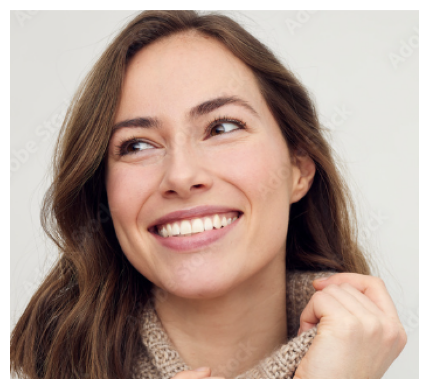

 28%|███████████▊                               | 11/40 [00:01<00:02, 10.29it/s]

images:./test/fh7.png, output:['male_sad']


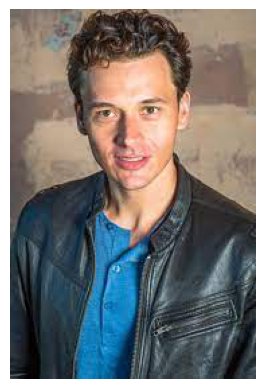

images:./test/ml-10.jpg, output:['male_sad']


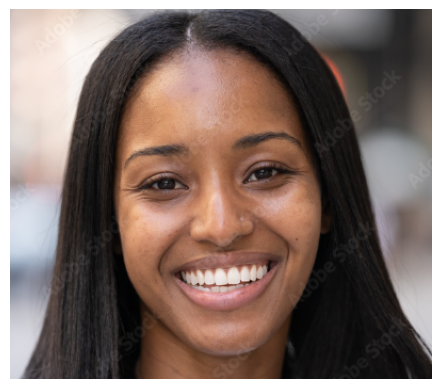

 32%|█████████████▉                             | 13/40 [00:01<00:02, 10.13it/s]

images:./test/fh10.png, output:['male_sad']


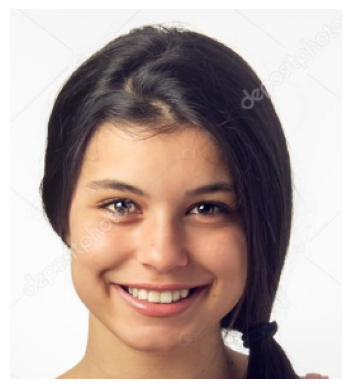

images:./test/fh6.png, output:['male_happy']


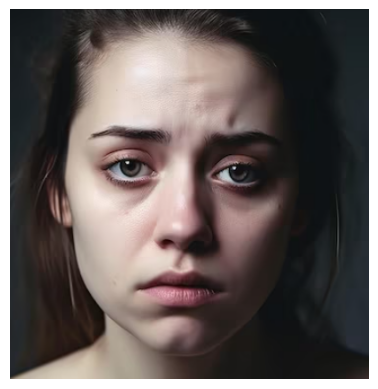

 38%|████████████████▏                          | 15/40 [00:01<00:02, 10.37it/s]

images:./test/fs10.png, output:['male_sad']


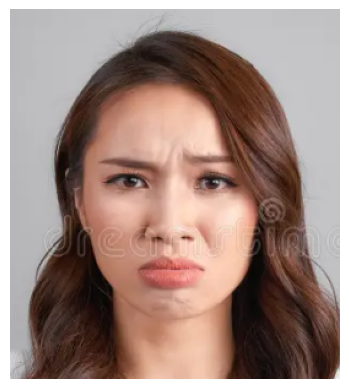

images:./test/fs8.png, output:['male_sad']


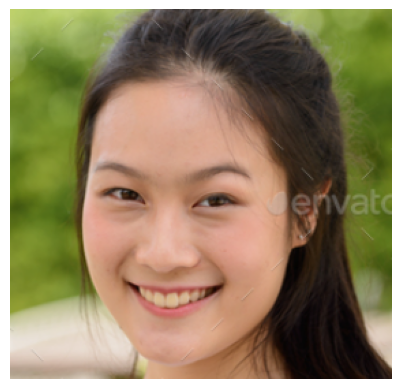

 42%|██████████████████▎                        | 17/40 [00:01<00:02, 10.19it/s]

images:./test/fh2.png, output:['male_happy']


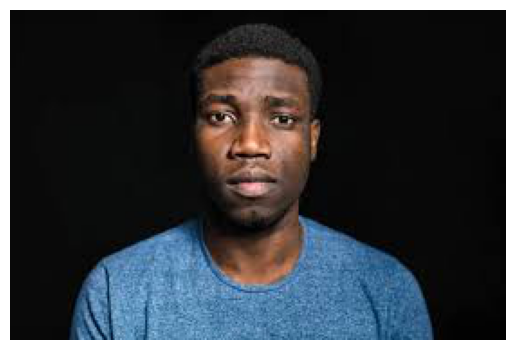

images:./test/ml-s-8.jpg, output:['male_sad']


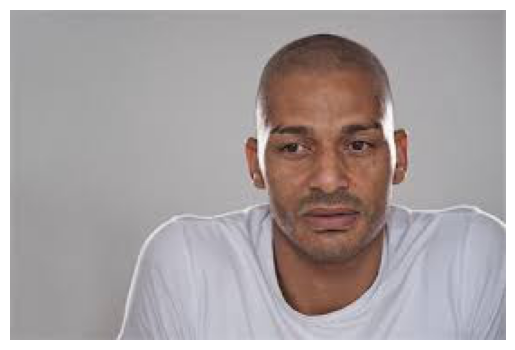

 48%|████████████████████▍                      | 19/40 [00:01<00:01, 11.12it/s]

images:./test/ml-s-9.jpg, output:['male_happy']


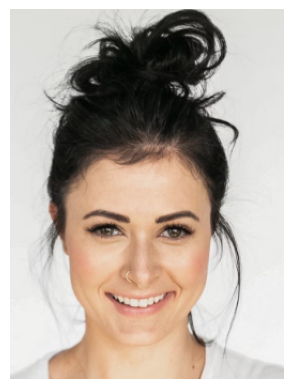

images:./test/fh3.png, output:['male_happy']


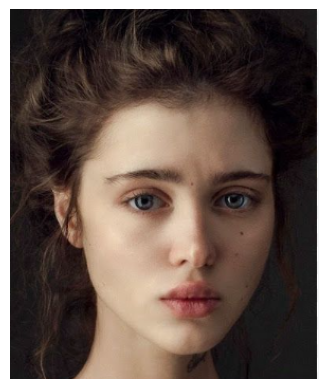

 52%|██████████████████████▌                    | 21/40 [00:01<00:01, 11.09it/s]

images:./test/fs9.png, output:['male_happy']


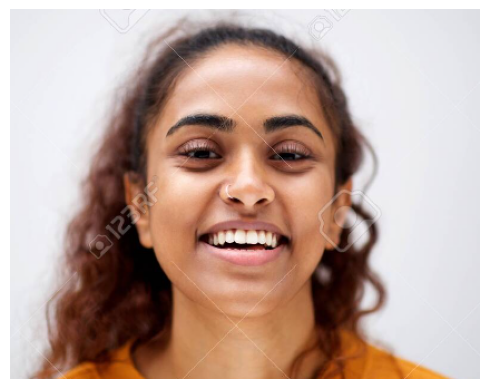

images:./test/fh1.png, output:['male_happy']


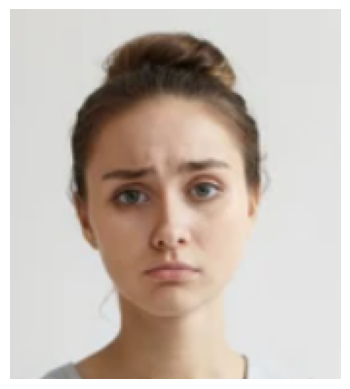

 57%|████████████████████████▋                  | 23/40 [00:02<00:01, 11.12it/s]

images:./test/fs7.png, output:['male_happy']


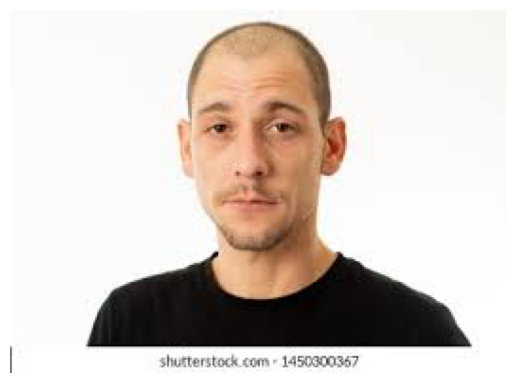

images:./test/ml-s-7.jpg, output:['male_sad']


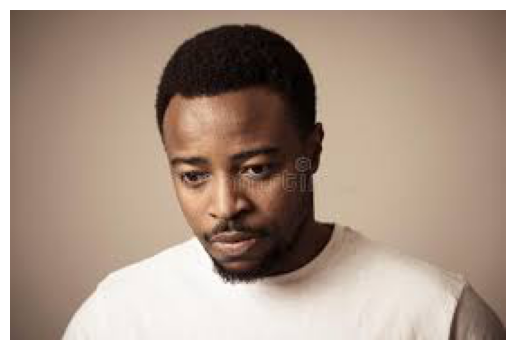

 62%|██████████████████████████▉                | 25/40 [00:02<00:01, 11.67it/s]

images:./test/ml-s-6.jpg, output:['male_happy']


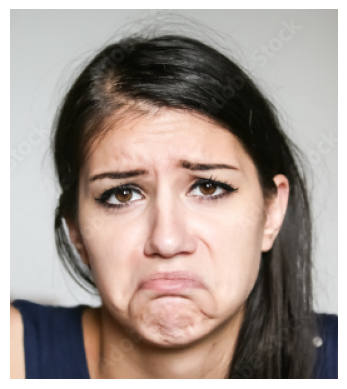

images:./test/fs6.png, output:['female_sad']


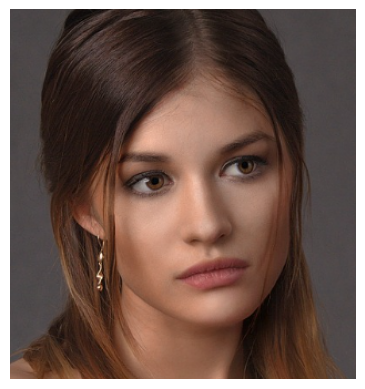

 68%|█████████████████████████████              | 27/40 [00:02<00:01, 11.15it/s]

images:./test/fs4.png, output:['male_sad']


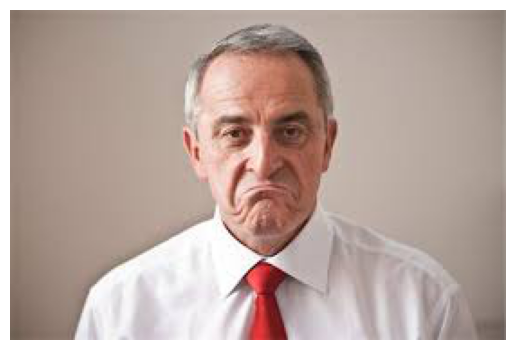

images:./test/ml-s-4.jpg, output:['male_happy']


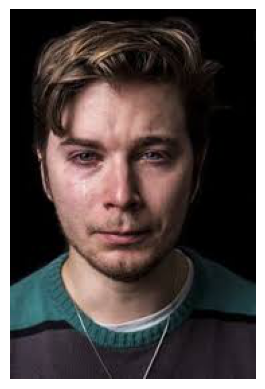

 72%|███████████████████████████████▏           | 29/40 [00:02<00:00, 11.85it/s]

images:./test/ml-s-5.jpg, output:['male_sad']


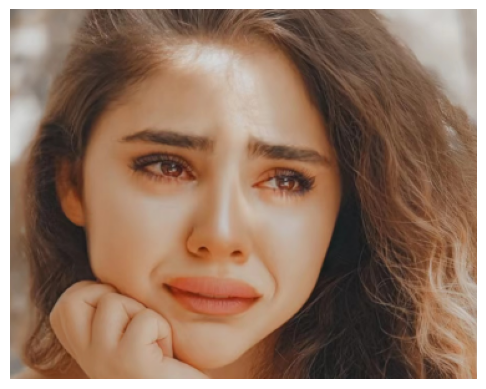

images:./test/fs5.png, output:['male_sad']


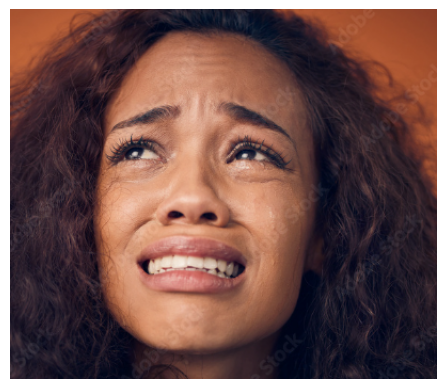

 78%|█████████████████████████████████▎         | 31/40 [00:02<00:00, 10.25it/s]

images:./test/fs1.png, output:['male_sad']


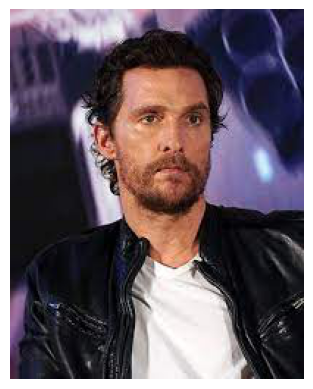

images:./test/ml-s-1.jpg, output:['male_sad']


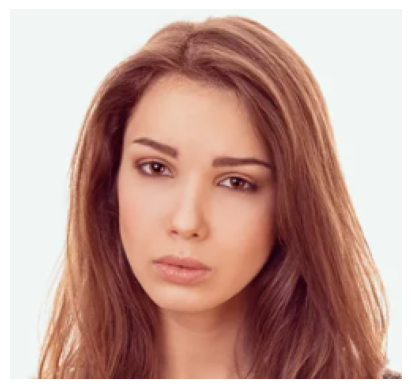

 82%|███████████████████████████████████▍       | 33/40 [00:03<00:00, 10.59it/s]

images:./test/fs2.png, output:['male_sad']


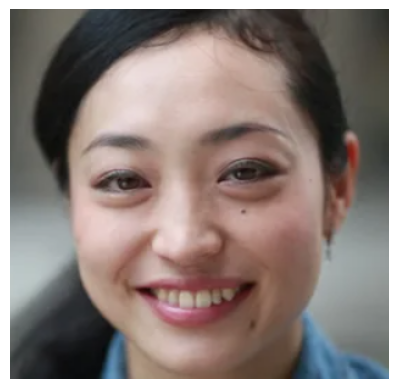

images:./test/fh8.png, output:['male_sad']


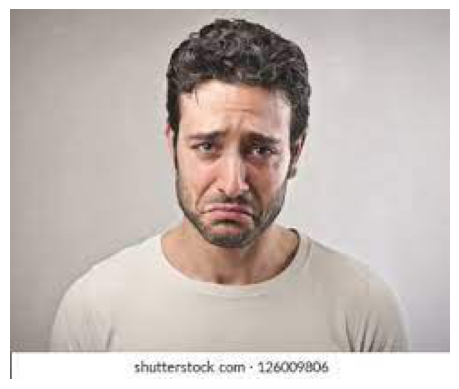

 88%|█████████████████████████████████████▋     | 35/40 [00:03<00:00, 10.74it/s]

images:./test/ml-s-2.jpg, output:['male_happy']


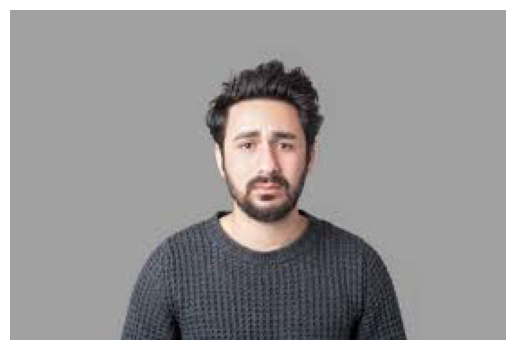

images:./test/ml-s-3.jpg, output:['male_happy']


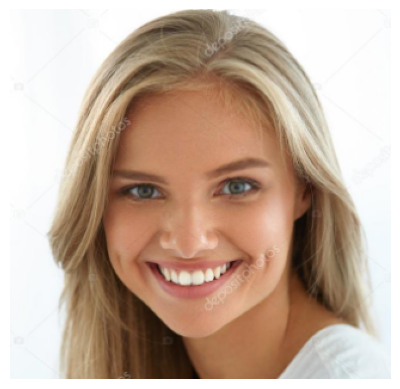

 92%|███████████████████████████████████████▊   | 37/40 [00:03<00:00, 10.89it/s]

images:./test/fh9.png, output:['male_sad']


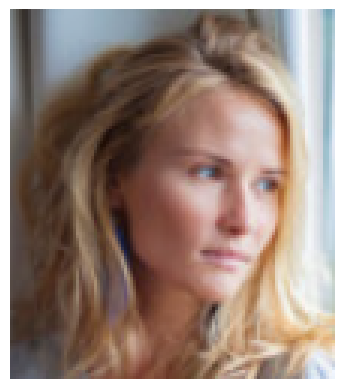

images:./test/fs3.png, output:['male_sad']


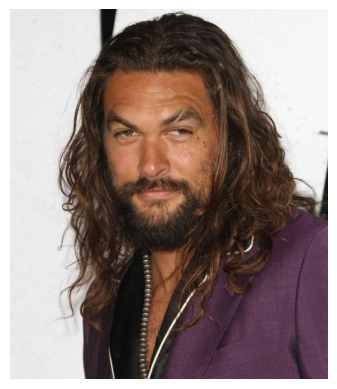

 98%|█████████████████████████████████████████▉ | 39/40 [00:03<00:00, 10.57it/s]

images:./test/ml-8.jpg, output:['male_happy']


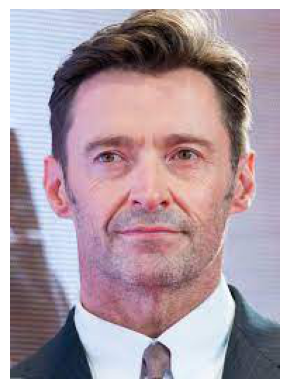

100%|███████████████████████████████████████████| 40/40 [00:03<00:00, 10.80it/s]

images:./test/ml-9.jpg, output:['male_happy']


In [73]:
output_testing(m3,"./test/")

  0%|                                                    | 0/40 [00:00<?, ?it/s]

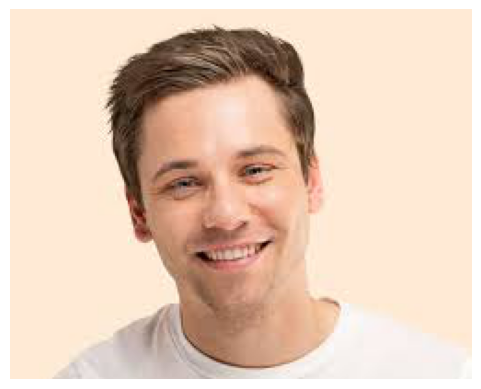

  2%|█                                           | 1/40 [00:00<00:04,  8.05it/s]

images:./test/ml-2.jpg, output:['male_happy']


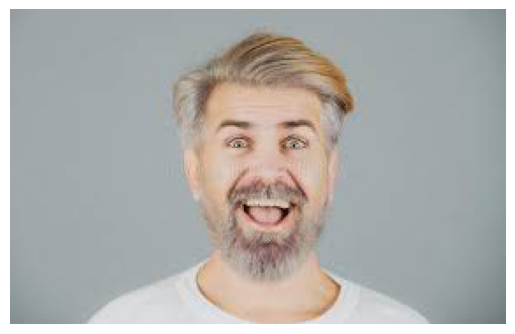

images:./test/ml-3.jpg, output:['male_happy']


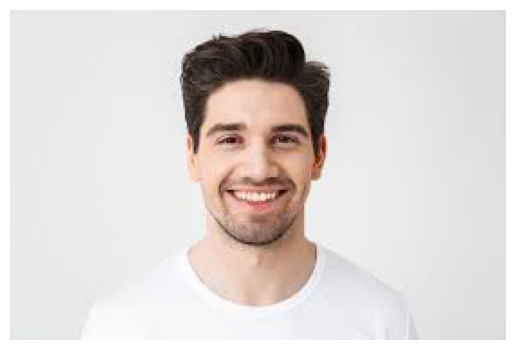

  8%|███▎                                        | 3/40 [00:00<00:03, 12.29it/s]

images:./test/ml-1.jpg, output:['male_happy']


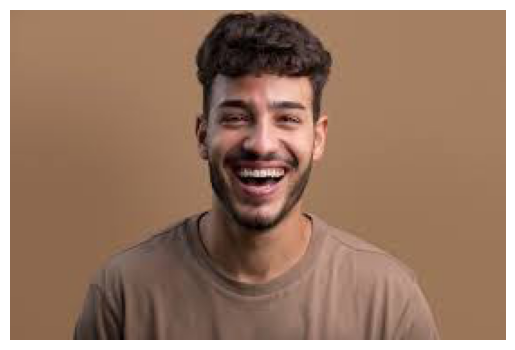

images:./test/ml-4.jpg, output:['male_sad']


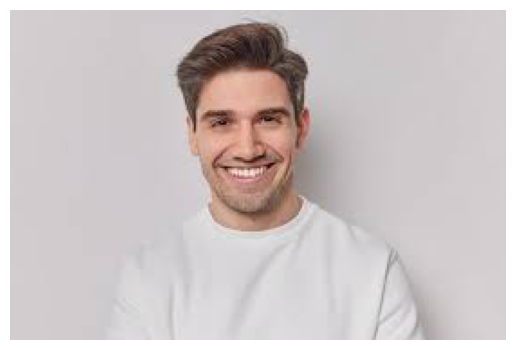

 12%|█████▌                                      | 5/40 [00:00<00:02, 13.10it/s]

images:./test/ml-5.jpg, output:['male_happy']


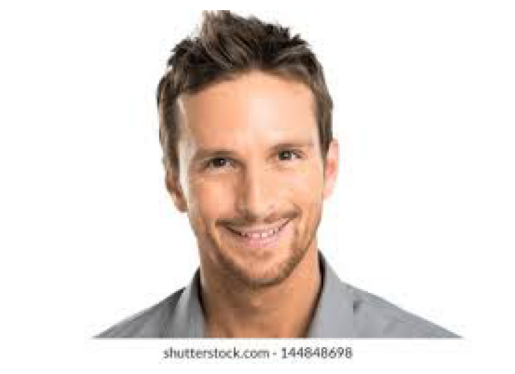

images:./test/ml-7.jpg, output:['male_happy']


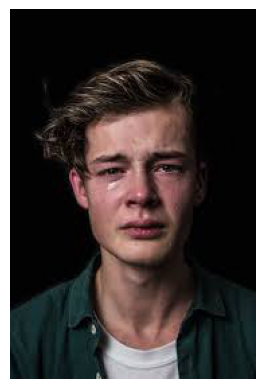

 18%|███████▋                                    | 7/40 [00:00<00:02, 13.65it/s]

images:./test/ml-s-10.jpg, output:['male_sad']


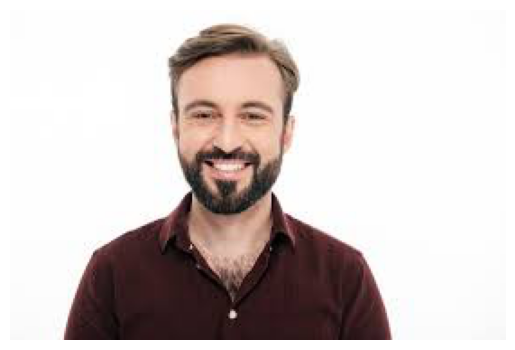

images:./test/ml-6.jpg, output:['male_happy']


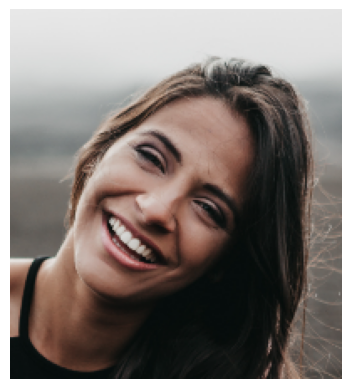

 22%|█████████▉                                  | 9/40 [00:00<00:02, 13.54it/s]

images:./test/fh4.png, output:['male_happy']


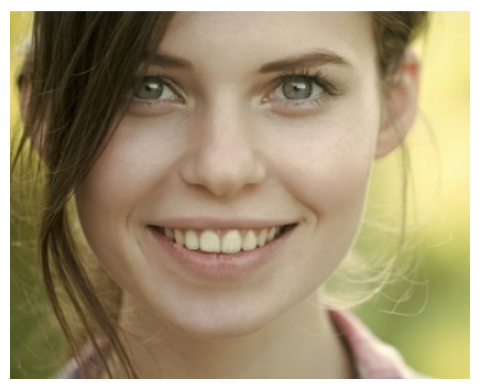

images:./test/fh5.png, output:['male_happy']


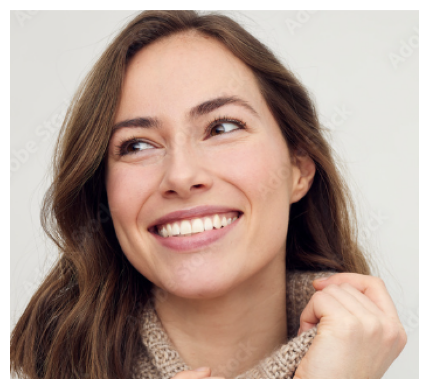

 28%|███████████▊                               | 11/40 [00:00<00:02, 11.22it/s]

images:./test/fh7.png, output:['male_happy']


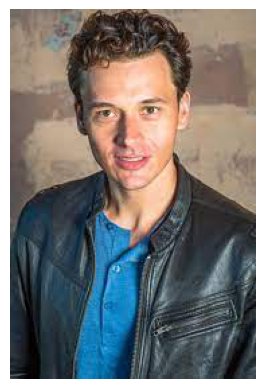

images:./test/ml-10.jpg, output:['male_sad']


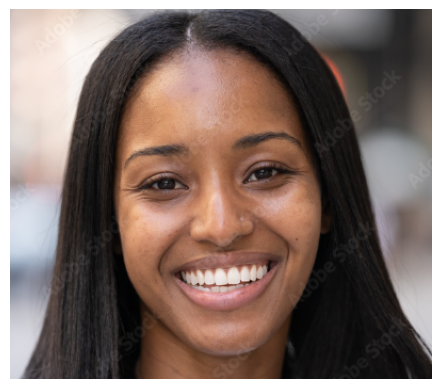

 32%|█████████████▉                             | 13/40 [00:01<00:02, 10.84it/s]

images:./test/fh10.png, output:['male_sad']


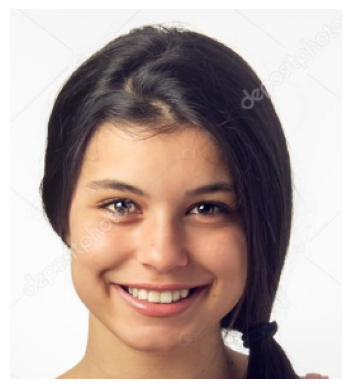

images:./test/fh6.png, output:['male_happy']


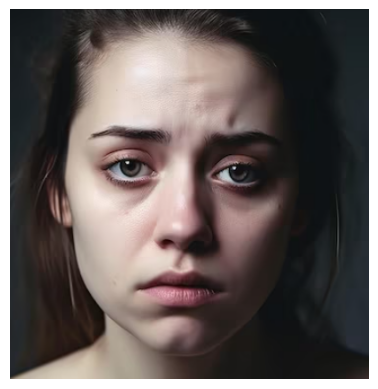

 38%|████████████████▏                          | 15/40 [00:01<00:02, 11.04it/s]

images:./test/fs10.png, output:['male_sad']


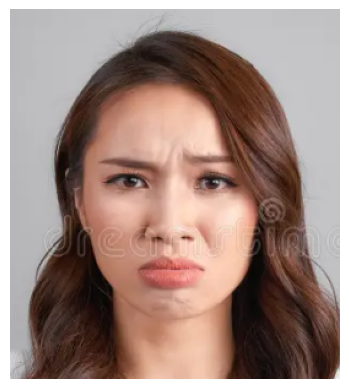

images:./test/fs8.png, output:['male_sad']


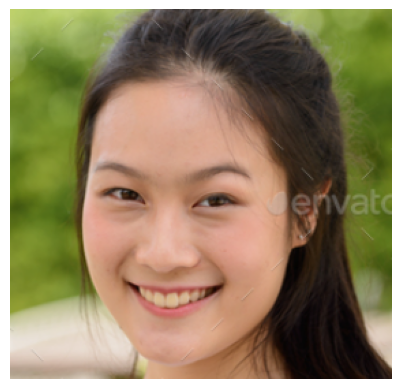

 42%|██████████████████▎                        | 17/40 [00:01<00:02, 10.60it/s]

images:./test/fh2.png, output:['male_happy']


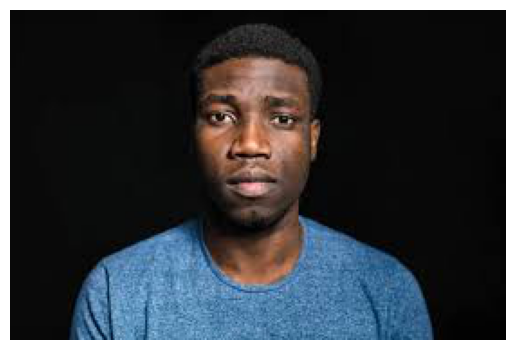

images:./test/ml-s-8.jpg, output:['male_sad']


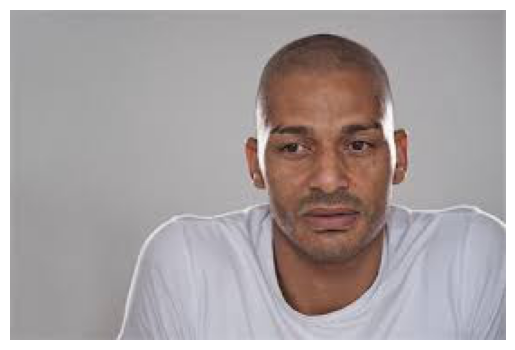

 48%|████████████████████▍                      | 19/40 [00:01<00:01, 11.37it/s]

images:./test/ml-s-9.jpg, output:['male_happy']


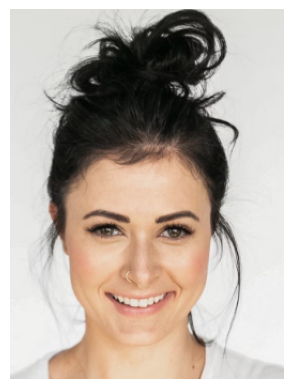

images:./test/fh3.png, output:['male_happy']


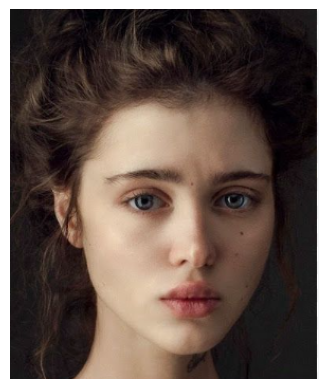

 52%|██████████████████████▌                    | 21/40 [00:01<00:01, 11.25it/s]

images:./test/fs9.png, output:['male_happy']


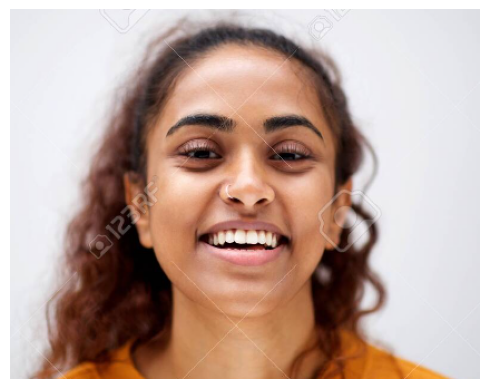

images:./test/fh1.png, output:['male_happy']


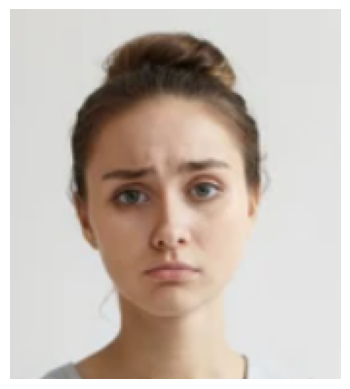

 57%|████████████████████████▋                  | 23/40 [00:02<00:01, 10.56it/s]

images:./test/fs7.png, output:['male_sad']


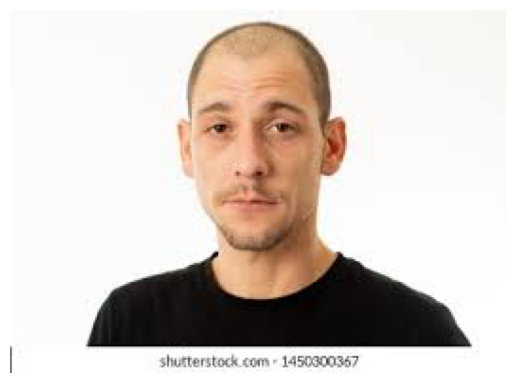

images:./test/ml-s-7.jpg, output:['male_sad']


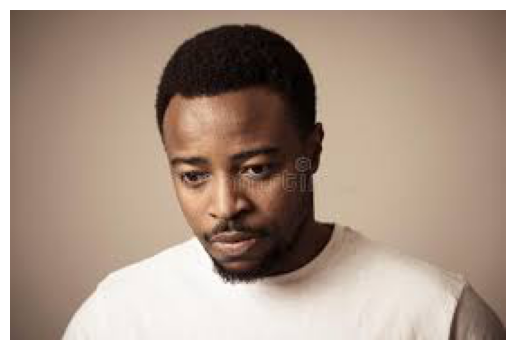

 62%|██████████████████████████▉                | 25/40 [00:02<00:01, 10.55it/s]

images:./test/ml-s-6.jpg, output:['male_happy']


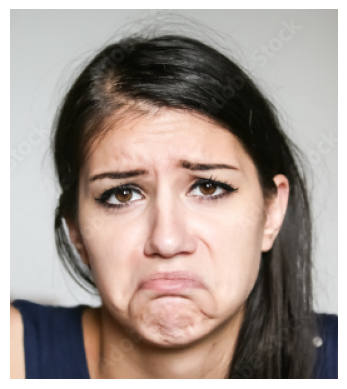

images:./test/fs6.png, output:['female_sad']


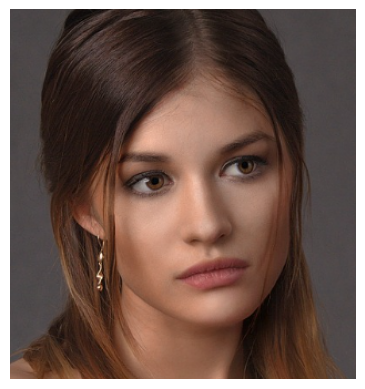

 68%|█████████████████████████████              | 27/40 [00:02<00:01, 10.20it/s]

images:./test/fs4.png, output:['male_happy']


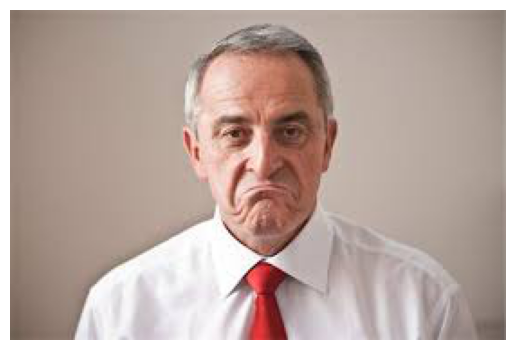

images:./test/ml-s-4.jpg, output:['male_happy']


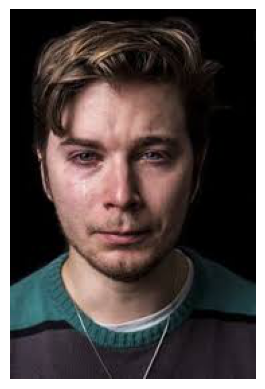

 72%|███████████████████████████████▏           | 29/40 [00:02<00:01, 10.87it/s]

images:./test/ml-s-5.jpg, output:['male_happy']


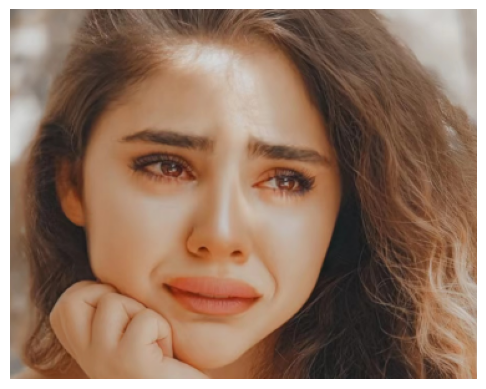

images:./test/fs5.png, output:['female_sad']


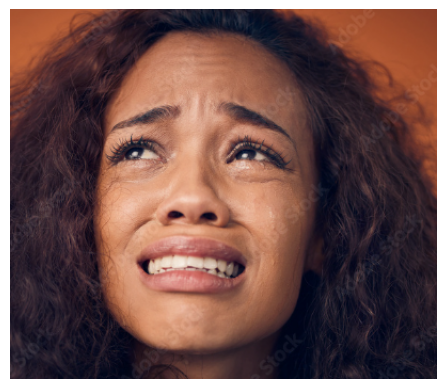

 78%|█████████████████████████████████▎         | 31/40 [00:02<00:00,  9.83it/s]

images:./test/fs1.png, output:['male_happy']


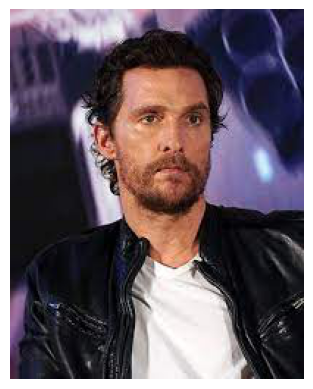

images:./test/ml-s-1.jpg, output:['male_sad']


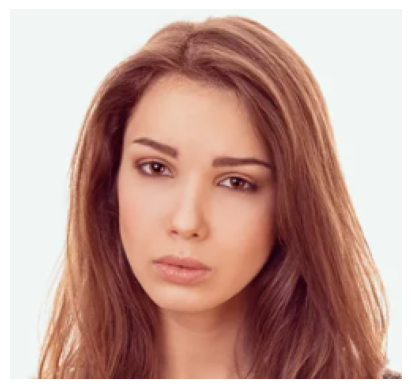

 82%|███████████████████████████████████▍       | 33/40 [00:03<00:00, 10.42it/s]

images:./test/fs2.png, output:['male_happy']


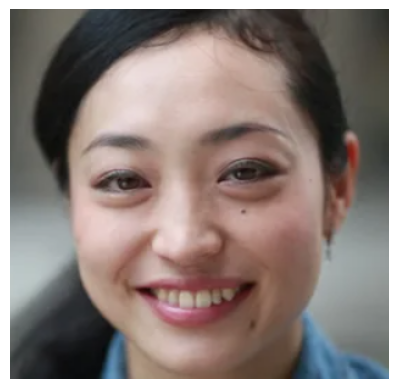

images:./test/fh8.png, output:['male_sad']


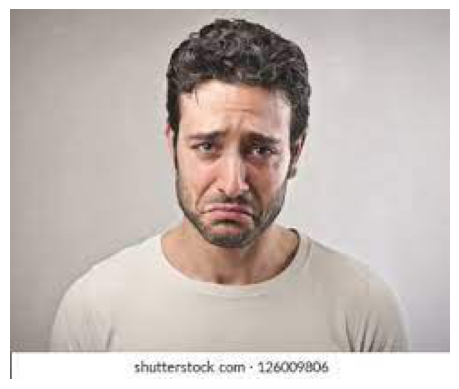

 88%|█████████████████████████████████████▋     | 35/40 [00:03<00:00, 10.61it/s]

images:./test/ml-s-2.jpg, output:['male_happy']


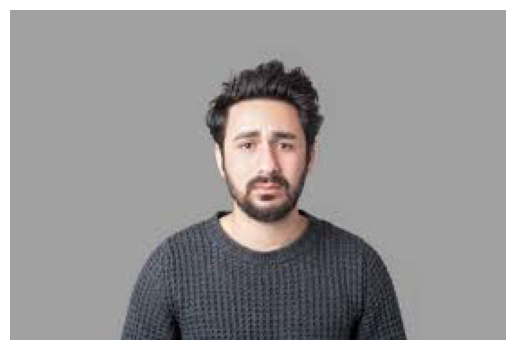

images:./test/ml-s-3.jpg, output:['male_happy']


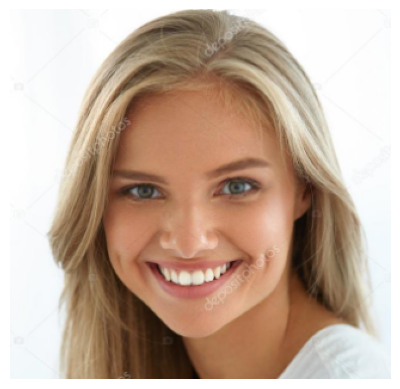

 92%|███████████████████████████████████████▊   | 37/40 [00:03<00:00, 11.02it/s]

images:./test/fh9.png, output:['male_sad']


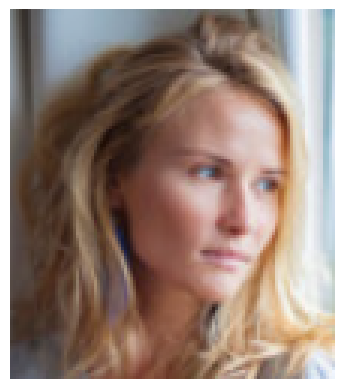

images:./test/fs3.png, output:['male_sad']


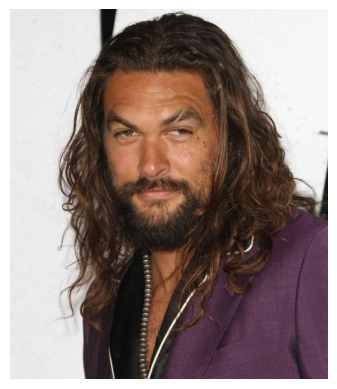

 98%|█████████████████████████████████████████▉ | 39/40 [00:03<00:00, 11.38it/s]

images:./test/ml-8.jpg, output:['male_sad']


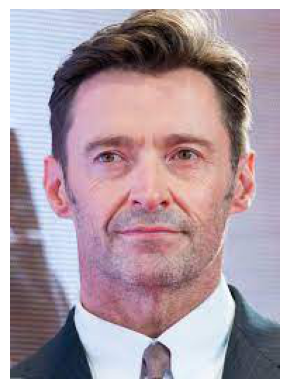

100%|███████████████████████████████████████████| 40/40 [00:03<00:00, 11.10it/s]

images:./test/ml-9.jpg, output:['male_happy']


In [74]:
output_testing(m4,"./test/")

### Conclusion:

In conclusion, We have best performing models, which can predict gender and emotion pretty accurately (7/10).
Experimenting on architectures till we get best performing model has to be done again.

This Project did help us understand how CNN works, Whats the importance of Lenet 5 architecture and the steps which we need to take or think before even thinking of predictions. 